# Code to Recreate all Figures 

In [1]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from mpl_toolkits.axes_grid1.axes_divider import make_axes_locatable

import matplotlib as mpl
from matplotlib import font_manager
mpl.rcParams['pdf.fonttype'] = 42
mpl.rcParams['ps.fonttype'] = 42
mpl.rcParams['font.size'] = 12
mpl.rcParams['font.family'] = 'sans-serif'
mpl.rcParams['font.sans-serif'] = 'Helvetica Neue'

params = {'legend.fontsize': 6,
             'axes.labelsize': 6,
             'axes.titlesize':6,
             'xtick.labelsize':6,
             'ytick.labelsize':6}


import matplotlib.pylab as pylab
pylab.rcParams.update(params)


from matplotlib.colors import LinearSegmentedColormap
c1='#B3262A'
c2='#2f559a'
c3 = "#FFFFFF"
cmap_classification_score = LinearSegmentedColormap.from_list("Prob_Unstim", [c2, c1], N=500)
cmap_unstim = LinearSegmentedColormap.from_list("Prob_Unstim", [c3, c1], N=500)
cmap_stim = LinearSegmentedColormap.from_list("Prob_Unstim", [c3, c2], N=500)

mm = 1/2.54 * 1/10  # mm in inches


# Figure 1

## Figure 1c

In [2]:
data = pd.read_csv("../data/Raw_Data_LMD_cell_counting.csv")
data.n_excised = [str(x) for x in data.n_excised]

data.groupby("n_excised").mean().reset_index()

,n_excised,Replicate,n_counted
0,100,3.0,79.4
1,500,1.5,387.5


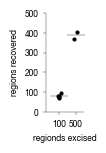

In [3]:
fig, axs = plt.subplots(1, 1, figsize = (28  * mm, 43 * mm))
sns.despine()

sns.stripplot(data, x = "n_excised", y = "n_counted", color = "black", s = 3, ax = axs)
sns.scatterplot(y="n_counted", x="n_excised", data= data.groupby("n_excised").mean().reset_index(), marker='_', s=150, color='k', ax = axs, linewidth = 0.25)


axs.set_ylim(0, 500)
axs.set_ylabel("regions recovered")
axs.set_xlabel("regionds excised")
axs.tick_params(axis='both', which='major', labelsize=6, size = 2, width = 0.25)
axs.spines["bottom"].set_linewidth(0.25)
axs.spines["left"].set_linewidth(0.25)
axs.set_xlim(-0.8, 1.5)

fig.tight_layout()
fig.savefig("../plots/LMD_region_counts.pdf", bbox_inches='tight')

## Figure 1d

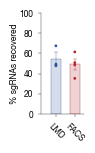

In [4]:
data = pd.read_csv("../data/Raw_Data_LMD_FACS_comparision_data.csv")

#convert to percent of selected cells
data["Mean"] = (data["Mean"] / data["count per replicate"] * 100)
data["Std"] = (data["Std"]/ data["count per replicate"] * 100)

#get values for plotting
plot_final = data.sort_values(by = "enrichment", ascending=False)

labels = plot_final.groupby("enrichment").mean()["Mean"].sort_values(ascending= False).index
mean = plot_final.groupby("enrichment").mean()["Mean"].sort_values(ascending= False).values
std = plot_final.groupby("enrichment").sem()["Mean"].sort_values(ascending= False).values

#actually generate plot
fig, axs = plt.subplots(1, 1, figsize = (28  * mm, 43 * mm))
sns.despine()

from matplotlib.colors import to_rgba
colors = [c2, c1]
colors_20per_alpha = [to_rgba(color, alpha = 0.2) for color in colors]

axs.scatter(plot_final.enrichment, plot_final.Mean, color = [colors[0]]*3 + [colors[1]]*4, s = 1)
axs.bar(labels, mean,  align='center', color =colors_20per_alpha, width = 0.5, edgecolor = colors, linewidth = 0.25) #ecolor= [c2, c1]

#add error bars
for pos, y, err, color in zip([0, 1], mean, std, colors):
    axs.errorbar(pos, y, err, capsize = 1.5, linewidth = 0.25, color = color, capthick = 0.25)

axs.set_ylabel("% sgRNAs recovered", fontsize = 6, labelpad=0.2)
axs.set_ylim(0, 100)
axs.set_xlim(-0.8, 1.5)

axs.set_xticks(ticks = [0, 1], labels = ["LMD", "FACS"], rotation = -45)
axs.tick_params(axis='both', which='major', labelsize=6, size = 2, width = 0.25)
axs.spines["bottom"].set_linewidth(0.25)
axs.spines["left"].set_linewidth(0.25)

fig.tight_layout()
fig.savefig("../plots/FACS_LMD_comparision.pdf", bbox_inches='tight')

# Figure 2

## Figure 2a

In [ ]:
from tifffile import imread

def colorize(im, color, clip_percentile=0.0):
    """
    Helper function to create an RGB image from a single-channel image using a 
    specific color.
    """
    # Check that we do just have a 2D image
    if im.ndim > 2 and im.shape[2] != 1:
        raise ValueError('This function expects a single-channel image!')
        
    # Rescale the image according to how we want to display it
    im_scaled = im.astype(np.float32) - np.percentile(im, clip_percentile)
    im_scaled = im_scaled / np.percentile(im_scaled, 100 - clip_percentile)
    im_scaled = np.clip(im_scaled, 0, 1)
    
    # Need to make sure we have a channels dimension for the multiplication to work
    im_scaled = np.atleast_3d(im_scaled)
    
    # Reshape the color (here, we assume channels last)
    color = np.asarray(color).reshape((1, 1, -1))
    return im_scaled * color

def generate_composite(images, colors = [(0, 0, 1),(0, 1, 0), (1, 0, 0), (1, 0, 1)], plot = False):
    
    colorized = []
    for image, color in zip(images, colors):
        image = colorize(image, color, 0.0)
        colorized.append(image)
    
    if plot:
        for i in colorized: 
            plt.figure()
            plt.imshow(i)
        
    image = colorized[0]
    for i in range(len(colorized)-1):
        image += colorized[i+1]
        
    return(np.clip(image, 0, 1))

def _percentile_norm(im, lower_value, upper_value):                          
    IPR = upper_value - lower_value

    out_im = im - lower_value 
    out_im = out_im / IPR
    out_im = np.clip(out_im, 0, 1)
            
    return out_im


#generate overview for unstim
image_paths = ["../data/example_imaged_100X_timecousre_LC3-mCherry/WT_Torin_Well2_tile10_ch2.tiff",
              "../data/example_imaged_100X_timecousre_LC3-mCherry/WT_Torin_Well2_tile10_ch1.tiff",
              "../data/example_imaged_100X_timecousre_LC3-mCherry/WT_Torin_Well2_tile10_ch3.tiff",
             ]

channels = []

for im_path in image_paths:
    _im = imread(im_path)
    _im = _im
    channels.append(_im)
channels = np.array(channels)

_images_stim = []
for i in range(channels.shape[1]):
    _im = channels[:, i, :550, 180:730]
    _images_stim.append(_im)
_images_stim = np.array(_images_stim)

#define timepoints we want to look at
timepoints = [0, 1, 2, 8, 14]
_images_stim = _images_stim[timepoints, : , :, :]

fig, axs = plt.subplots(4, 5, figsize = (32, 24))

#normalize all images to the range of the brightest image (to preserve relativ comparision)
min_value = [np.quantile(_img, 0.01) for _img in _images_stim[-1]]
max_value = [np.quantile(_img, 0.99) for _img in _images_stim[-1]]

#normalization needs to be 
for i, img in enumerate(_images_stim):
    normed = [_percentile_norm(_img, min_value[j], max_value[j])for j, _img in enumerate(img)]
    colorized = generate_composite(normed, ((1, 0, 0),(0,1, 0), (0, 0, 1)))
    
    if i == 0:
        axs[0, i].imshow(colorized)
        axs[0, i].xaxis.set_visible(False)
        axs[0, i].tick_params(left=False, labelleft=False)  
        axs[0, i].set_title(f"{timepoints[i]}h", fontsize = 30)

        axs[1, i].imshow(normed[0], cmap = "gray")
        axs[1, i].xaxis.set_visible(False)
        axs[1, i].tick_params(left=False, labelleft=False)  

        axs[2, i].imshow(normed[1], cmap = "gray")
        axs[2, i].xaxis.set_visible(False)
        axs[2, i].tick_params(left=False, labelleft=False)  

        axs[3, i].imshow(normed[2], cmap = "gray")
        axs[3, i].xaxis.set_visible(False)
        axs[3, i].tick_params(left=False, labelleft=False)  
        
    else:
        axs[0, i].imshow(colorized)
        axs[0, i].axis("off")  
        axs[0, i].set_title(f"{timepoints[i]}h", fontsize = 30)

        axs[1, i].imshow(normed[0], cmap = "gray")
        axs[1, i].axis("off")  

        axs[2, i].imshow(normed[1], cmap = "gray")
        axs[2, i].axis("off")  

        axs[3, i].imshow(normed[2], cmap = "gray")
        axs[3, i].axis("off")  

axs[0, 0].set_ylabel("mCherry-LC3\nmembrane\nnucleus", fontsize = 30, rotation = 0, labelpad=110)
axs[1, 0].set_ylabel("mCherry-LC3", fontsize = 30, rotation = 0, labelpad=110)
axs[2, 0].set_ylabel("membrane", fontsize = 30, rotation = 0, labelpad=110)
axs[3, 0].set_ylabel("nucleus", fontsize = 30, rotation = 0, labelpad=110)
    
fig.tight_layout()
fig.savefig("../plots/Torin_stimulation_WT_cells_timecourse_100X.pdf", bbox_inches='tight')

## Figure 2d

In [6]:
data = pd.read_csv("../data/Screen_A1_Raw_Data_Autophagy_Enrichment.csv", index_col = 0)
data = data.set_index("labels")

/home/sophia/miniconda3/envs/viper-core3.8/lib/python3.8/site-packages/seaborn/categorical.py:3543: UserWarning: 27.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


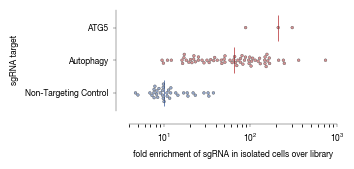

In [7]:
from matplotlib.colors import to_rgba

ATG5_color = "#B3262A"
autophagy_color = "#B3262A"
non_targeting_color = "#2F559A"

ATG5_values = data.loc["ATG5"].values
non_targeting_controls = data.loc["Non-Targeting Control"].values
autophagy_values = data.loc["Autophagy"].values

median_ATG5 = np.median(ATG5_values)
median_non_targeting_controls = np.median(non_targeting_controls)
median_autophagy_values = np.median(autophagy_values)

df = pd.concat([pd.DataFrame({"values":ATG5_values.flatten(), "labels": ["ATG5"]*len(ATG5_values)}),
              pd.DataFrame({"values":autophagy_values.flatten(), "labels" : ["Autophagy"]*len(autophagy_values)}),
              pd.DataFrame({"values":non_targeting_controls.flatten(), "labels" : ["Non-Targeting Control"]*len(non_targeting_controls)})])


fig, axs = plt.subplots(1, 1, figsize = (94 * mm, 47 * mm))
sns.despine(offset = {"left": 10, "bottom":10})
axs.set_xlabel("enrichment of gRNAs")

sns.swarmplot(df, x = "values", y = "labels", ax = axs, dodge = False, hue = "labels", s = 2,
              palette = {"ATG5":to_rgba(ATG5_color, alpha = 0.5), "Autophagy":to_rgba(autophagy_color, alpha = 0.5), "Non-Targeting Control":to_rgba(non_targeting_color, alpha = 0.5)},
              edgecolors = [ATG5_color, autophagy_color, non_targeting_color], linewidth = 0.25
             )

# sns.swarmplot(df, x = "values", y = "labels", ax = axs, dodge = False, hue = "labels", s = 3, linewidth = 0.25, fill = None)

axs.set_ylabel("sgRNA target", fontsize = 6)
axs.set_xlabel("fold enrichment of sgRNA in isolated cells over library", fontsize = 6)
axs.vlines(x = median_ATG5, ymin = -0.4, ymax = 0.4, color = ATG5_color, linewidth = 0.5 )
axs.vlines(x = median_autophagy_values, ymin = 0.6, ymax = 1.4, color = autophagy_color, linewidth = 0.5 )
axs.vlines(x = median_non_targeting_controls, ymin = 1.6, ymax = 2.4, color = non_targeting_color, linewidth = 0.5 )

#adjust limits so that ticks end at edge of scale
axs.set_xlim(4, 1000)
axs.set_xscale("log")

axs.tick_params(axis='both', which='major', labelsize=6, size = 2, width = 0.25)
axs.spines["bottom"].set_linewidth(0.25)
axs.spines["left"].set_linewidth(0.25)

axs.legend(bbox_to_anchor=(1.5, 1), frameon=False).remove()
fig.tight_layout()
fig.savefig("../plots/Screen_A1_swarmplot_autophagy_genes.pdf", transparent=False, format='pdf', bbox_inches='tight')

# Figure 3

## Figure 3a


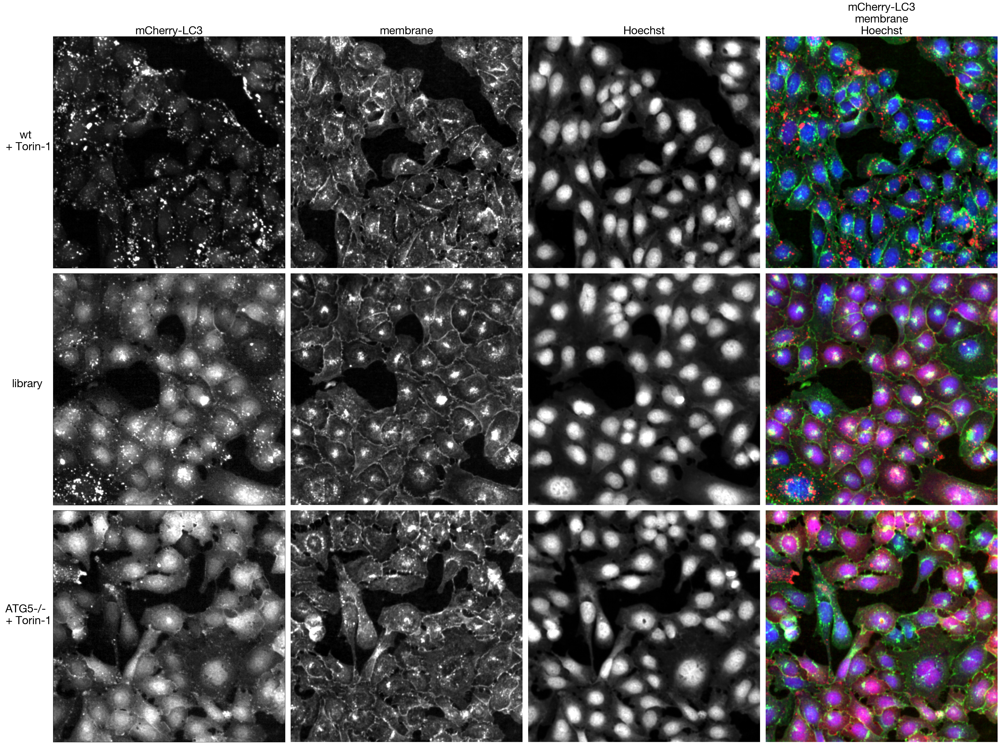

In [8]:
from tifffile import imread

def colorize(im, color, clip_percentile=0.0):
    """
    Helper function to create an RGB image from a single-channel image using a 
    specific color.
    """
    # Check that we do just have a 2D image
    if im.ndim > 2 and im.shape[2] != 1:
        raise ValueError('This function expects a single-channel image!')
        
    # Rescale the image according to how we want to display it
    im_scaled = im.astype(np.float32) - np.percentile(im, clip_percentile)
    im_scaled = im_scaled / np.percentile(im_scaled, 100 - clip_percentile)
    im_scaled = np.clip(im_scaled, 0, 1)
    
    # Need to make sure we have a channels dimension for the multiplication to work
    im_scaled = np.atleast_3d(im_scaled)
    
    # Reshape the color (here, we assume channels last)
    color = np.asarray(color).reshape((1, 1, -1))
    return im_scaled * color

def generate_composite(images, colors = [(0, 0, 1),(0, 1, 0), (1, 0, 0), (1, 0, 1)], plot = False):
    """
    Helper function to generate a colorized overalyed image from multiple individual images
    """
    
    colorized = []
    for image, color in zip(images, colors):
        image = colorize(image, color, 0.0)
        colorized.append(image)
    
    if plot:
        for i in colorized: 
            plt.figure()
            plt.imshow(i)
        
    image = colorized[0]
    for i in range(len(colorized)-1):
        image += colorized[i+1]
        
    return(np.clip(image, 0, 1))


fig, axs = plt.subplots(3, 4, figsize = (37.5, 28))

images = [f"../data/example_images_training_data/WT_Torin",
          f"../data/example_images_training_data/Library_Unstim",
          f"../data/example_images_training_data/ATG5_Torin"
         ]

channels = ["mCherryLC3", "WGA488", "Hoechst" ]

for i, image_path in enumerate(images):
    
    image = []
    
    for channel in channels:
        image.append(imread(f"{image_path}_{channel}.tif"))

    image = np.array(image)
    colorized = generate_composite(image, ((1, 0, 0), (0,1, 0), (0, 0, 1) ))
    
    axs[i, 3].imshow(colorized)
    axs[i, 3].axis("off")  

    axs[i, 0].imshow(image[0], cmap = "gray")
    axs[i, 0].xaxis.set_visible(False)
    axs[i, 0].tick_params(left=False, labelleft=False)
    
    axs[i, 1].imshow(image[1], cmap = "gray")
    axs[i, 1].axis("off")  
    
    axs[i, 2].imshow(image[2], cmap = "gray")
    axs[i, 2].axis("off")  


    
axs[0, 0].set_title(f"mCherry-LC3", fontsize = 30)  
axs[0, 1].set_title(f"membrane", fontsize = 30)
axs[0, 2].set_title(f"Hoechst", fontsize = 30)
axs[0, 3].set_title(f"mCherry-LC3\nmembrane\nHoechst", fontsize = 30)


axs[0, 0].set_ylabel("wt \n + Torin-1", rotation = 0, fontsize = 30, labelpad=70)
axs[1, 0].set_ylabel("library", rotation = 0, fontsize = 30, labelpad=70)
axs[2, 0].set_ylabel("ATG5-/- \n + Torin-1", rotation = 0, fontsize = 30, labelpad=70)

fig.tight_layout()
fig.savefig("../plots/Classifier2_Example_Training_Data.pdf")


## Figure 3c

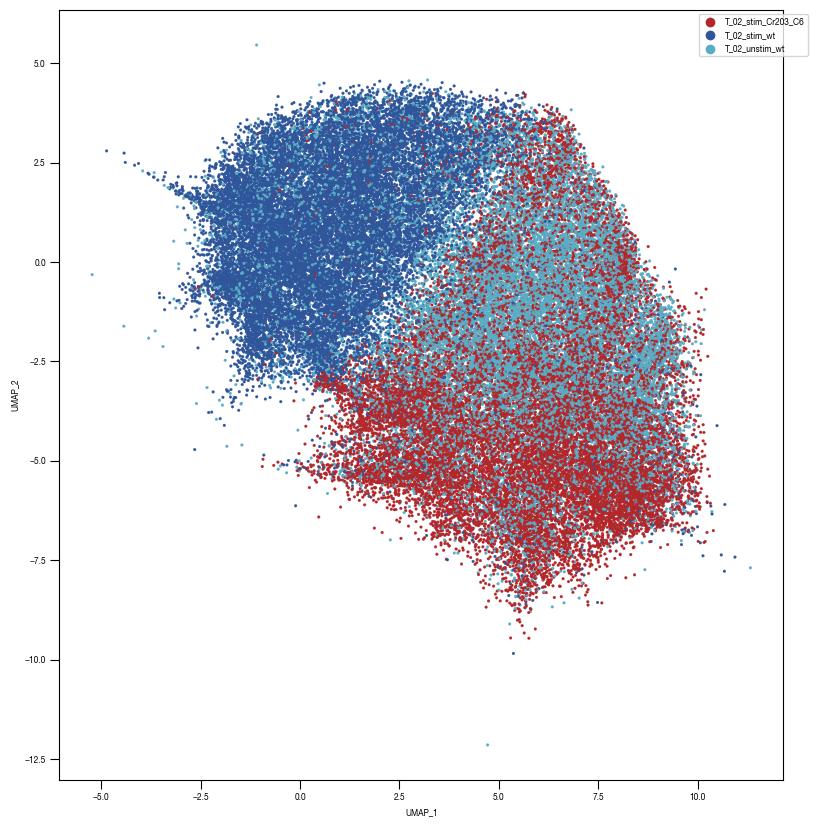

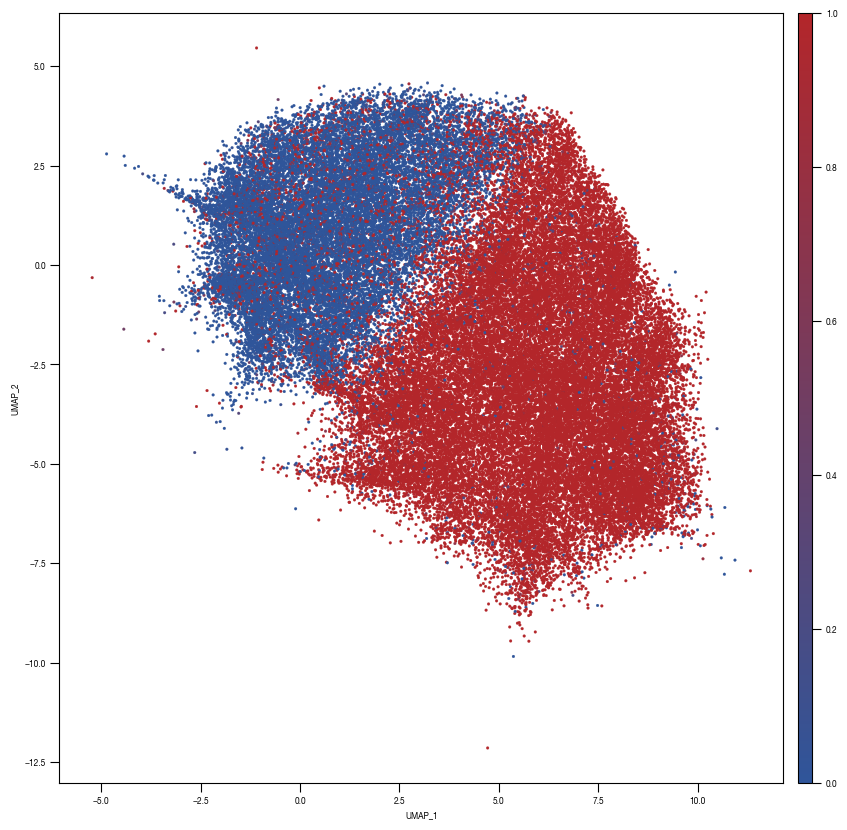

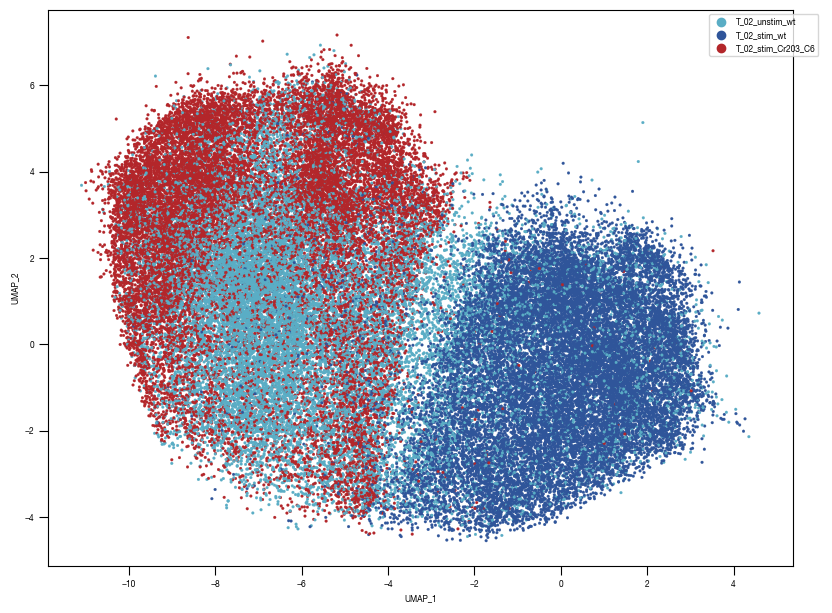

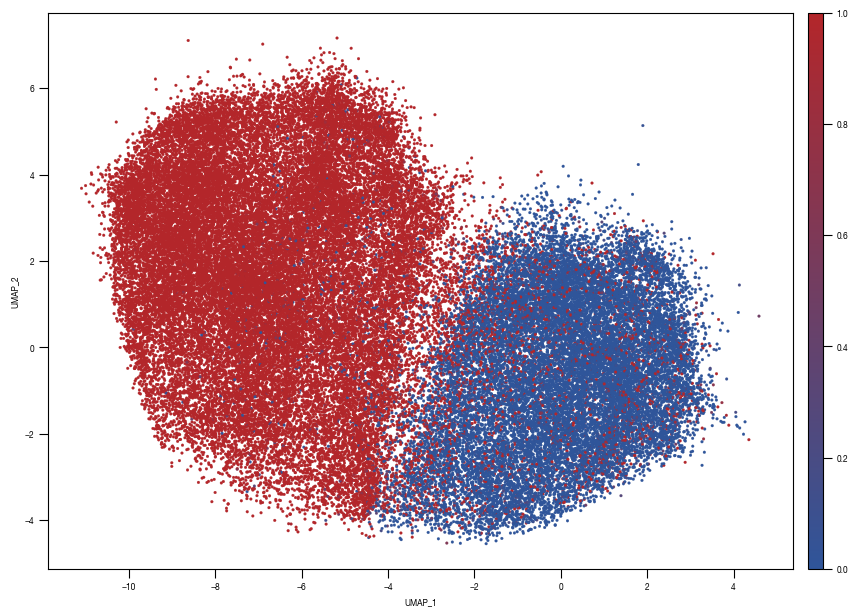

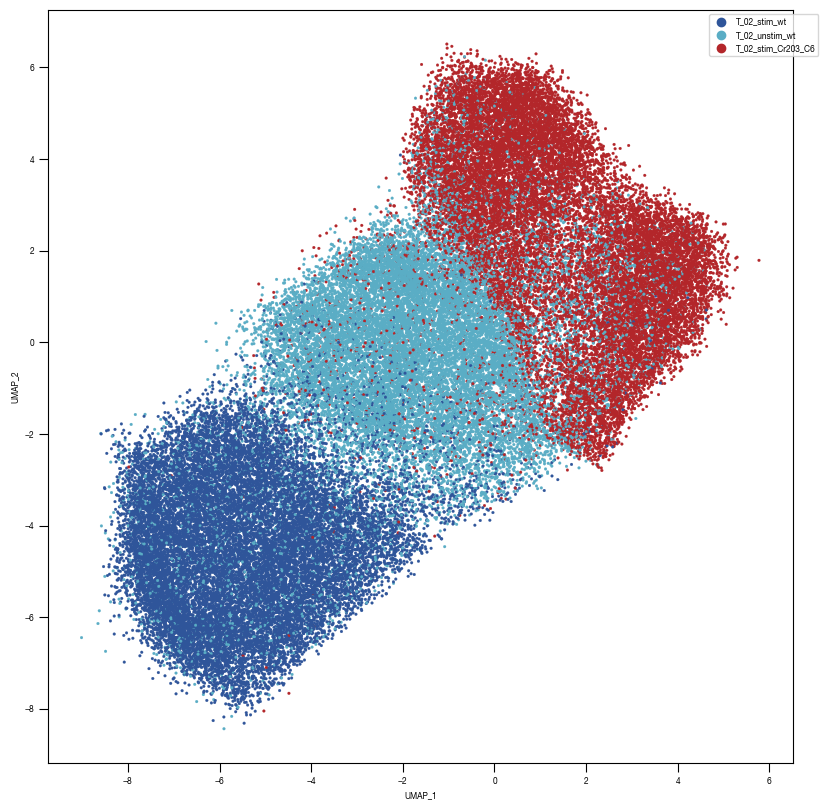

...

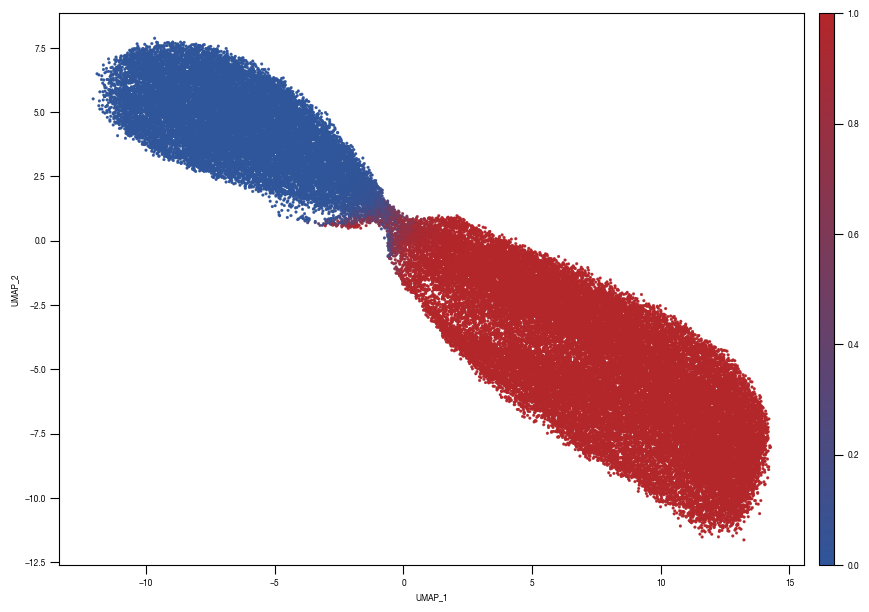

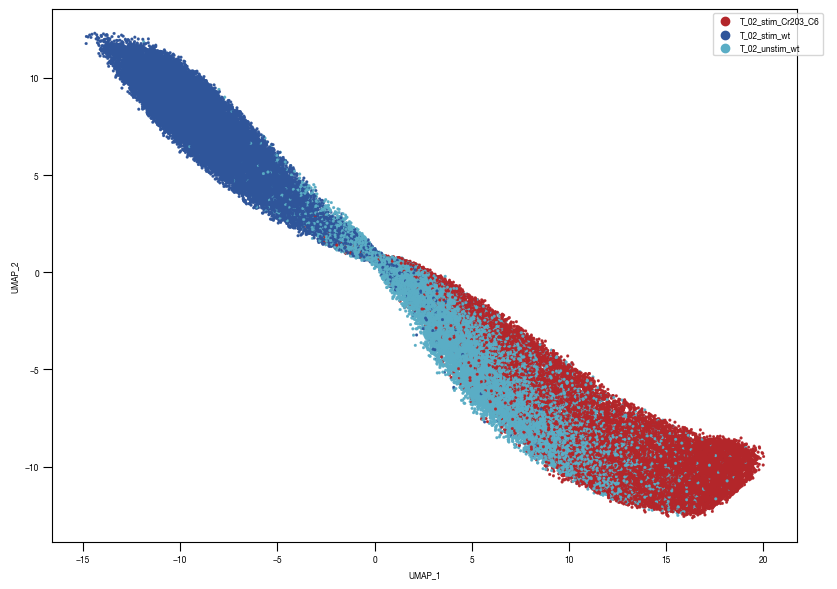

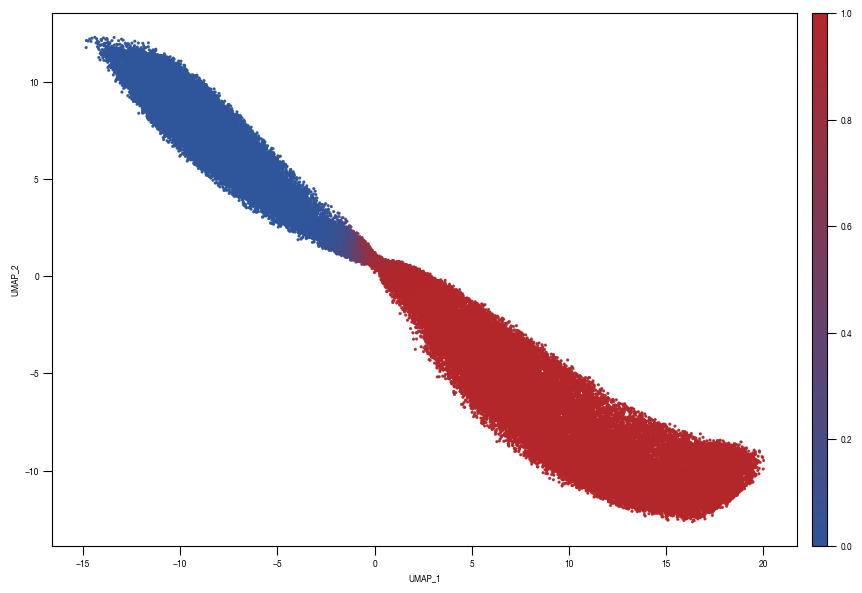

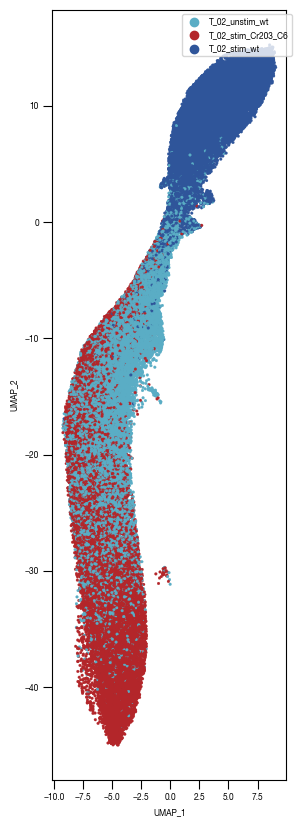

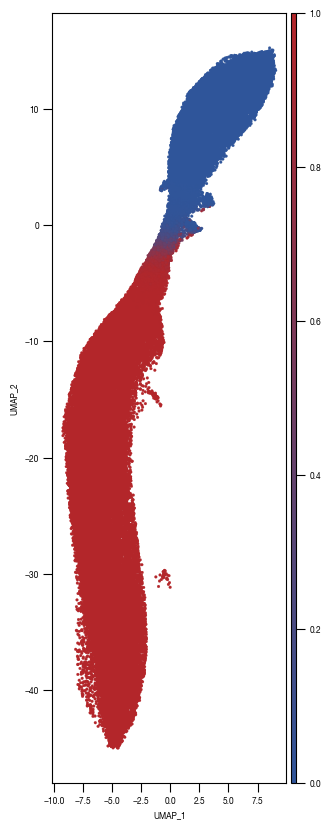

In [9]:
layers = ["conv2d5", "conv2d6", "conv2d7","conv2d8","conv2d9", "linear1", "linear2", "linear3"]

for layer in layers: 
        
    input = f"../data/classifier_2.0_Test_Data/UMAP_data/Raw_data_UMAP_{layer}.csv"
    df_train_umap = pd.read_csv(input)

    outdir = f"../plots/UMAP_classifier2.0_layers/"
    
    ### Plot 1 Labels
    fig, axs = plt.subplots(1, 1, figsize = (10, 10))
    
    
    color_dict = dict({'T_02_stim_Cr203_C6':"#B3262A",
                       "T_02_stim_wt":'#2f559a',
                       "T_02_unstim_wt":"#5AADC5", 
                      })
    ax = sns.scatterplot(df_train_umap.sample(frac=1, random_state = 19),  x = "UMAP_1", y = "UMAP_2", s = 4, hue = "class_label", alpha = 1, palette = color_dict, ax = axs, edgecolor = None, rasterized=True)
    axs.tick_params(size = 3.5*1.773)

    legend = ax.get_legend()
    ax.get_legend().remove()

    ax1_divider = make_axes_locatable(ax)
    cax1 = ax1_divider.append_axes("right", size="2%", pad="2%")
    cax1.axis("off")
    cax1.legend(*ax.get_legend_handles_labels(), bbox_to_anchor = (1, 1))
    
    ax.set_aspect('equal', adjustable='box')
    # fig.tight_layout()
    fig.savefig(f"{outdir}/UMAP_test_data_labels_{layer}.pdf", dpi = 500)

    ### PLOT 2: prob unstim
    fig, axs = plt.subplots(1, 1, figsize = (10, 10))
    
    ax = sns.scatterplot(data = df_train_umap.sample(frac=1, random_state = 19),  x = "UMAP_1", y = "UMAP_2", s = 4, hue = "prob_unstim", alpha = 1, ax = axs, palette=cmap_classification_score, edgecolor = None, rasterized = True)
    axs.tick_params(size = 3.5*1.773)

    norm = plt.Normalize(0, 1)
    sm = plt.cm.ScalarMappable(cmap=cmap_classification_score, norm=norm)
    sm.set_array([])

    # Remove the legend and add a colorbar
    ax.get_legend().remove()

    ax1_divider = make_axes_locatable(ax)
    cax1 = ax1_divider.append_axes("right", size="2%", pad="2%")
    cb1 = fig.colorbar(sm, cax=cax1)
    cax1.tick_params(size = 3.5*1.773)
    
    ax.set_aspect('equal', adjustable='box')
    fig.savefig(f"{outdir}/UMAP_test_data_prob_unstim_{layer}.pdf", dpi = 500)

## Figure 3d

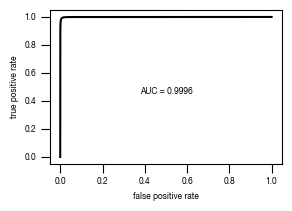

In [10]:
#load previously saved data
subsampled_classification_results = pd.read_csv("../data/T02_Raw_Data_classifier_metrics_classifier_2.0_2.1.csv")
versions = ["classifier_2.0"]

from sklearn.metrics import precision_recall_curve, roc_curve, auc
labels = ["stim", "ATG5_KO_Cr203_C6"]

results_all = {}
auc_values = {}

for version in versions:
    data = subsampled_classification_results.loc[[x in labels for x in subsampled_classification_results.label]].get([version, "label"])
    true_label = [0 if x == "stim" else 1 for x in data.label]
    scores = data[version].tolist()
    
    fpr, tpr, thresholds = roc_curve(true_label, scores)
    precision, recall, thresholds = precision_recall_curve(true_label, scores)
    fdr = 1 - precision
    
    auc_roc = auc(fpr, tpr)
    auc_precision_recall = auc(recall, precision)
    auc_values[version] = pd.DataFrame({"ROC":[auc_roc], "precision_recall":[auc_precision_recall]})
    
    fig, axs = plt.subplots(1, 1, figsize = (3, 2))
    axs.plot(fpr, tpr, color = "black")
    axs.set_xlabel("false positive rate")
    axs.set_ylabel("true positive rate")
    axs.tick_params(axis='both', which='major', labelsize=6, size = 3.5*1.773)
    auc_results = "{0:.4g}".format(auc_values[version].ROC[0])
    axs.text(x = 0.5, y= 0.45, s= f"AUC = {auc_results}", fontsize = 6, horizontalalignment= "center")
    fig.savefig(f"../plots/{version}/T02_{version}_tpr_fpr_curve.pdf")

## Figure 3e

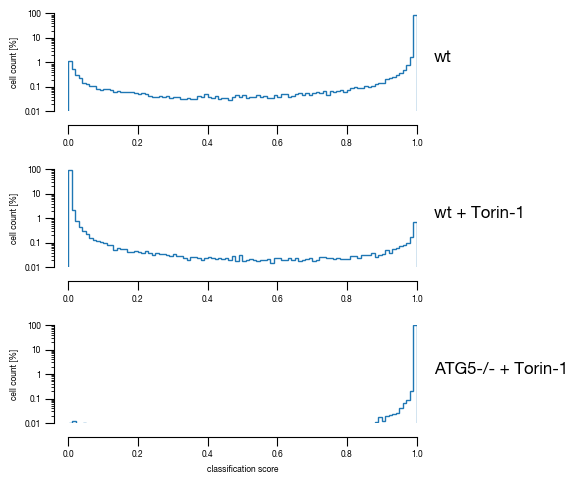

In [11]:
#load previously saved data
subsampled_classification_results = pd.read_csv("../data/T02_Raw_Data_classifier_metrics_classifier_2.0_2.1.csv")

slides = ["unstim", "stim", "ATG5_KO_Cr203_C6"]
labels = ["wt", "wt + Torin-1", "ATG5-/- + Torin-1"]
versions = ["classifier_2.0"]

from matplotlib.ticker import FormatStrFormatter

for version in versions:

    fig, axs = plt.subplots(3, 1, figsize = (6, 5), sharey = True)
    sns.despine(offset = 10)

    for i, slide in enumerate(slides):
        data = subsampled_classification_results.loc[[x == slide for x in subsampled_classification_results.label]].get([version])
        hist = axs[i].hist(data, bins = 100, cumulative = False, histtype='step', bottom = 0, weights = np.ones(len(data)) / len(data)*100)
        axs[i].set_ylim(0.01, 100)
        axs[i].set_yscale("log")
        axs[i].set_xlim(0, 1)
        axs[i].yaxis.set_major_formatter(FormatStrFormatter('%.3g'))

        axs[i].set_ylabel("cell count [%]")
        axs[i].tick_params(size = 3.5*1.773)
       
        axs[i].text(1.05, 1, s = labels[i])

    axs[i].set_xlabel("classification score")
    fig.tight_layout()
    fig.savefig(f"../plots/{version}/T02_{version}_Histogram_classifier_performance_lines.pdf", bbox_inches='tight')

## Figure 3f

/tmp/ipykernel_1703410/188811484.py:50: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


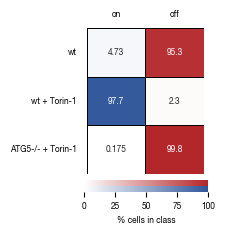

In [12]:
#load previously saved data
subsampled_classification_results = pd.read_csv("../data/T02_Raw_Data_classifier_metrics_classifier_2.0_2.1.csv")

sample_label_lookup = {"unstim":"wt", "stim":"wt + Torin-1", "ATG5_KO_Cr203_C6":"ATG5-/- + Torin-1"}

versions = ["classifier_2.0"]
n_cells = subsampled_classification_results.label.value_counts()[0]

for version in versions:
    _df = subsampled_classification_results.copy()
    _df["threshold_label"] = _df[version] >= 0.5    
    
    heatmap_data = pd.DataFrame(_df.groupby("label").sum().threshold_label/n_cells*100)
    heatmap_data.columns = ["unstimulated"]
    heatmap_data["stimulated"] = 100 - heatmap_data.unstimulated

    fig, axs = plt.subplots(1, 2, figsize = (2.3,2), sharex=False, sharey=True, gridspec_kw = {'wspace':0, 'hspace':0})
    
    cbar_ax1 = fig.add_axes([0.4, 0, 0.54, 0.03])
    cbar_ax2 = fig.add_axes([0.4, 0.03, 0.54, 0.03])
    
    sns.heatmap(heatmap_data.stimulated.to_frame().sort_index(ascending= False), annot = True, ax = axs[0], 
                cmap= cmap_stim, cbar_kws={'label': '% cells in class', "orientation": "horizontal"}, fmt = ".3g", vmax=100, vmin = 0, cbar_ax=cbar_ax1, 
                linewidths=0.5, linecolor='black',
                annot_kws={"size": 6})
    sns.heatmap(heatmap_data.unstimulated.to_frame().sort_index(ascending= False), annot = True, ax = axs[1], 
                cmap= cmap_unstim, cbar_kws={ "orientation": "horizontal"}, fmt = ".3g", vmax=100, vmin = 0, cbar_ax=cbar_ax2, 
                linewidths=0.5, linecolor='black', 
                annot_kws={"size": 6})
    
    #remove axis from second colorbar
    cbar_ax2.axis("off")
    
    #reassign labels into readable format
    labels = [sample_label_lookup[item.get_text()] for item in axs[0].get_yticklabels()]
    axs[0].set_yticklabels(labels)
    axs[0].set_xticklabels(["on"])
    axs[1].set_xticklabels(["off"])

    #move x-axis ticks to top and remove ticks
    axs[0].xaxis.set_ticks_position('top')
    axs[1].xaxis.set_ticks_position('top')
    axs[0].tick_params(left=False, top=False, bottom = False, rotation = 0)
    axs[1].tick_params(left=False, top=False, bottom = False, rotation = 0)
    
    #remove ylabel
    axs[0].set_ylabel(None)
    axs[1].set_ylabel(None)
    
    fig.tight_layout()
    fig.savefig(f"../plots/{version}/T02_{version}_heatmap.pdf", bbox_inches='tight')

## Figure 3g

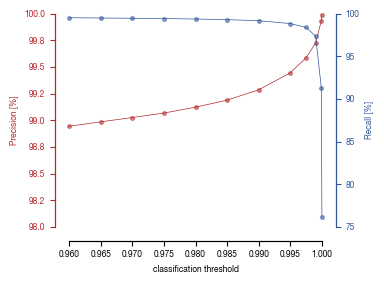

In [13]:
#load previously saved data
subsampled_classification_results = pd.read_csv("../data/T02_Raw_Data_classifier_metrics_classifier_2.0_2.1.csv")

thresholds = [0.99999, 0.9999, 0.999, 0.9975, 0.995, 0.99, 0.985, 0.98, 0.975, 0.97, 0.965, 0.96]  
labels = ["stim", "ATG5_KO_Cr203_C6"]

color1 = "#B3262A"
color2 = "#2f559a"

versions = ["classifier_2.0"]

for version in versions:
    results = pd.read_csv(f"../data/{version}_Test_Data/{version}_precision_recall_data.csv", index_col = 0)
    
    fig, axs = plt.subplots(1, 1, figsize = (4, 3))
    sns.despine(offset = 10)
    axs.plot(results.index.tolist(), results.precision.tolist(), clip_on = False, linewidth = 0.5, color = color1)
    axs.scatter(x = results.index.tolist(), y = results.precision.tolist(), clip_on = False, alpha = 0.5, s = 7, color = color1)
    axs.set_ylabel("Precision [%]", color = color1, fontsize = 6)
    axs.set_xlabel("classification threshold", fontsize = 6)
    axs.set_xlim(0.96, 1)

    if version == 'classifier_2.1':
        axs.set_ylim(96, 100)
    elif version == 'classifier_2.0':
        axs.set_ylim(98, 100)
        
    axs.yaxis.set_major_formatter(FormatStrFormatter('%.1f'))

    # twin object for two different y-axis on the sample plot
    axs2=axs.twinx()

    sns.despine(offset = 10, right = False)
    # make a plot with different y-axis using second axis object
    axs2.plot(results.index.tolist(), results.recall.tolist(), color = color2, clip_on = False, linewidth = 0.5)
    axs2.scatter(x = results.index.tolist(), y = results.recall.tolist(), color = color2, clip_on = False, alpha = 0.5, s = 7, linewidth = 1)
    axs2.set_ylabel("Recall [%]", color = color2, fontsize = 6)
    if version == 'classifier_2.1':
        axs2.set_ylim(91, 100)
    elif version == 'classifier_2.0':
        axs2.set_ylim(75, 100)

    axs.tick_params(axis='both', which='major', labelsize=6)
    axs2.tick_params(axis='both', which='major', labelsize=6)
    
    #setting up X-axis label color to yellow
    axs.yaxis.label.set_color(color1)          
    axs.tick_params(axis='y', colors=color1)    
    axs.spines['left'].set_color(color1)
    
    axs2.yaxis.label.set_color(color2)          
    axs2.tick_params(axis='y', colors=color2)    
    axs2.spines['left'].set_color(color1)
    axs2.spines['right'].set_color(color2)   

    fig.tight_layout()
    fig.savefig(f"../plots/{version}/T02_{version}_Precision_recall_overlayed.pdf",  bbox_inches='tight')

# Figure 4

## Figure 4b

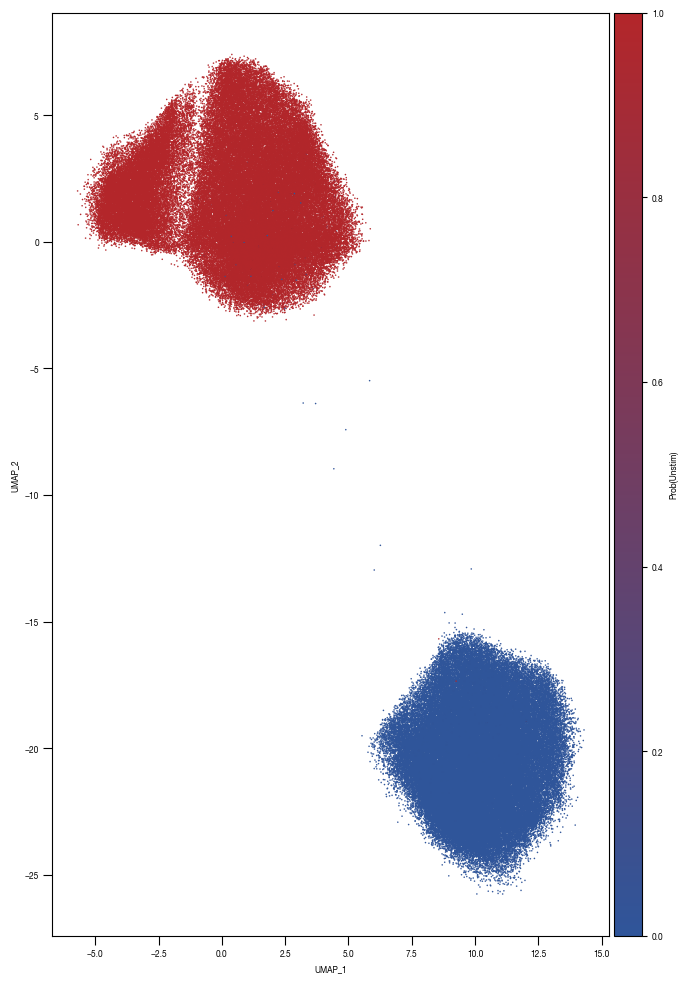

In [14]:
df_umap = pd.read_csv("../data/Screen_Analysis/screen_batches/Screen_B2_raw_data_UMAP.csv", index_col = 0)

from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib.colors import LinearSegmentedColormap

fig, axs = plt.subplots(1, 1, figsize = (10, 10))

c1='#B3262A'
c2='#2f559a'
c3 = "#FFFFFF"
cmap1 = LinearSegmentedColormap.from_list("Prob_Unstim", [c2, c1], N=500)
cmap = cmap1

sns.scatterplot(df_umap.sort_values(by= "class_label").sample(frac=1, random_state = 16),  x = "UMAP_1", y = "UMAP_2", s = 1, hue = "prob_unstim", alpha = 1, palette = cmap, ax = axs, edgecolor = None, rasterized=True)
sns.move_legend(axs, "upper left", bbox_to_anchor=(1, 1))
axs.set_aspect('equal', adjustable='box')
axs.tick_params(size = 3.5*1.773)

divider = make_axes_locatable(axs)
cax = divider.append_axes('right', size='5%', pad=0.05)

norm = plt.Normalize(0, 1.0)
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])

fig.colorbar(sm, cax=cax, orientation='vertical', label = "Prob(Unstim)")

# Remove the legend and add a colorbar
axs.get_legend().remove()

fig.tight_layout()
fig.savefig("../plots/Screen_Analysis/Screen_B2_UMAP_classification_score_colored.pdf", dpi = 500)

## Figure 4c

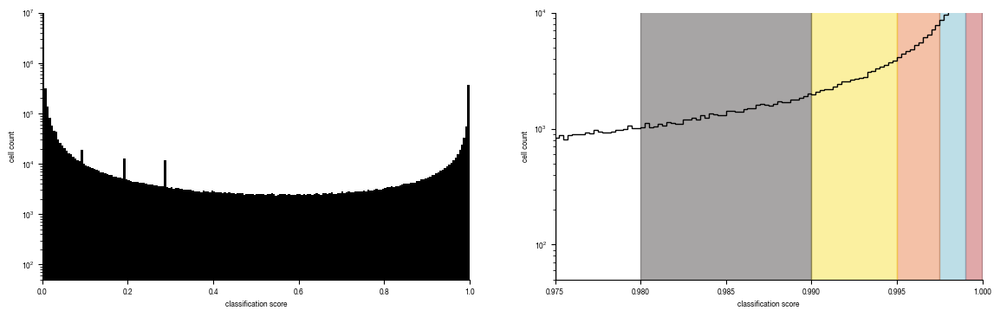

In [15]:
all_results = pd.read_parquet("../data/Screen_Analysis/screen_batches/ScreenB2_raw_data_cell_classification_values_with_bin_annotation.parquet")

bins = {"bin1": (0.99999, 1.0),
         "bin2": (0.999, 0.99999),
         "bin3": (0.9975, 0.999),
         "bin4": (0.995, 0.9975),
         "bin5": (0.99, 0.995),
         "bin6": (0.98, 0.99),
        } 

colors = ['#2f559a',"#B3262A","#5AADC5","#E46425","#F5DB12","#231F20","#D1D3D4"]

fig, axs = plt.subplots(1, 2, figsize = (14, 4))
sns.despine(offset = 0)

axs[0].hist(all_results.Prob_Unstim, bins = 200, bottom = 0, histtype = "stepfilled", color = "black");
axs[0].set_yscale("log")
axs[0].set_ylabel("cell count")
axs[0].set_xlabel("classification score")
axs[0].set_ylim(50, 10000000)
axs[0].set_xlim(0, 1)

hist = axs[1].hist(all_results[all_results.Prob_Unstim >= 0.975].Prob_Unstim, bins = 100, bottom = 0, histtype = "step", linewidth = 1, color = "black");
axs[1].set_yscale("log")
axs[1].set_ylabel("cell count")
axs[1].set_xlabel("classification score")
axs[1].set_xlim(0.975, 1)
axs[1].set_ylim(50, 10000)

for i, _bin in enumerate(bins.keys()):
    lower, upper = bins[_bin]
    
    rectangle = plt.Rectangle((lower, 0), upper-lower, hist[0].max(), fc=colors[i], alpha = 0.4, edgecolor = colors[i])
    plt.gca().add_patch(rectangle)

    
fig.savefig("../plots/Screen_Analysis/ScreenB2_binning_strategy.pdf")

## Figure 4d

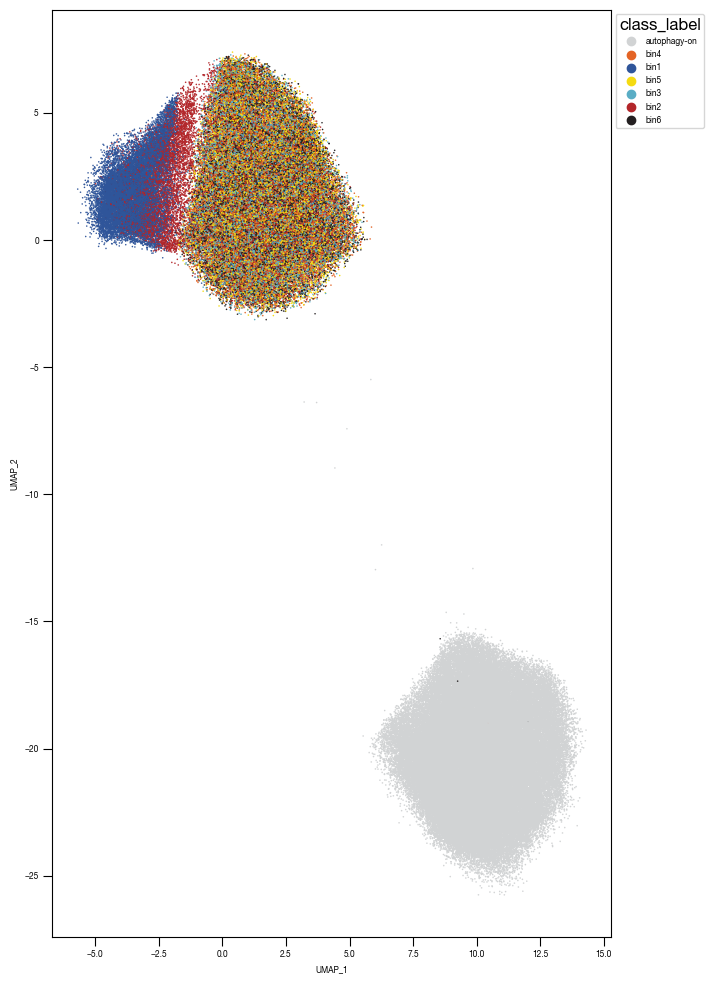

In [16]:
df_umap = pd.read_csv("../data/Screen_Analysis/screen_batches/Screen_B2_raw_data_UMAP.csv", index_col = 0)

fig, axs = plt.subplots(1, 1, figsize = (10, 10))

color_dict = dict({'bin1':'#2f559a',
                   "bin2":"#B3262A",
                   "bin3":"#5AADC5", 
                   "bin4":"#E46425",
                   "bin5":"#F5DB12",
                   "bin6":"#231F20",
                   "autophagy-on":"#D1D3D4"
                  })
sns.scatterplot(df_umap.sort_values(by= "class_label").sample(frac=1, random_state = 16),  x = "UMAP_1", y = "UMAP_2", s = 1, hue = "class_label", alpha = 1, palette = color_dict, ax = axs, edgecolor = None, rasterized=True)
sns.move_legend(axs, "upper left", bbox_to_anchor=(1, 1))
axs.set_aspect('equal', adjustable='box')
axs.tick_params(size = 3.5*1.773)

fig.tight_layout()
fig.savefig("../plots/Screen_Analysis/Screen_B2_UMAP_bins_colored.pdf", dpi = 500)

## Figure 4f

p-values were calculated in prism with the file /data/Screen_Analysis/zscore_pvalue_analysis.pzfx and added in illustrator

individual genes were annotated manually in illustrator on the basis of the interactive plots

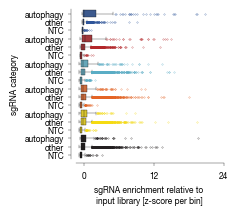

In [55]:
all_results = pd.read_csv("../data/Screen_Analysis/Raw_Data_Sequencing_Analysis_gRNA_count_table.csv", index_col = 0)

import seaborn as sns
import scipy.stats as stats

_plot = all_results.get(["gene", "autophagy_gene"] + [x for x in all_results.columns if x.startswith("enrichment") or x.startswith("Enrichment")])
_plot = _plot.replace(0, np.NaN)
_plot = pd.concat([_plot.get(["gene", "autophagy_gene"]), stats.zscore(_plot[[x for x in _plot.columns if x.startswith("enrichment") or x.startswith("Enrichment")]], nan_policy = "omit")], axis = 1)
_plot = _plot.melt(id_vars= ["gene", "autophagy_gene"])

_plot.loc[_plot.autophagy_gene, "gene"] = "01_autophagy_gene"
_plot["gene"] = ["02_other" if x not in ["01_autophagy_gene", "Non-Targeting Control"] else x for x in _plot.gene]
_plot["label"] = [str(x) + str(y) for x,y in zip(_plot.variable, _plot.gene)]

_plot = _plot.sort_values(["variable", "gene"])
_plot = _plot.dropna()


import matplotlib.colors
colors = ['#2f559a', '#2f559a', '#2f559a', "#B3262A", "#B3262A", "#B3262A", "#5AADC5", "#5AADC5", "#5AADC5", "#E46425", "#E46425", "#E46425", "#F5DB12", "#F5DB12", "#F5DB12", "#231F20", "#231F20", "#231F20"]
labels_data = ['enrichment_bin101_autophagy_gene',
 'enrichment_bin102_other',
 'enrichment_bin1Non-Targeting Control',
 'enrichment_bin201_autophagy_gene',
 'enrichment_bin202_other',
 'enrichment_bin2Non-Targeting Control',
 'enrichment_bin301_autophagy_gene',
 'enrichment_bin302_other',
 'enrichment_bin3Non-Targeting Control',
 'enrichment_bin401_autophagy_gene',
 'enrichment_bin402_other',
 'enrichment_bin4Non-Targeting Control',
 'enrichment_bin501_autophagy_gene',
 'enrichment_bin502_other',
 'enrichment_bin5Non-Targeting Control',
 'enrichment_bin601_autophagy_gene',
 'enrichment_bin602_other',
 'enrichment_bin6Non-Targeting Control']

labels_plot = ['autophagy',
 'other',
 'NTC',
 'autophagy',
 'other',
 'NTC',
 'autophagy',
 'other',
 'NTC',
 'autophagy',
 'other',
 'NTC',
 'autophagy',
 'other',
 'NTC',
 'autophagy',
 'other',
 'NTC']

color_dict = dict(zip(labels_data, colors))
label_dict = dict(zip(labels_data, labels_plot))

# ticks = [0, 1, 2, 3.5, 4.5, 5.5, 7, 8, 9, 10.5, 11.5,12.5, 14, 15, 16, 17.5, 18.5, 19.5]
# position_dict = dict(zip(label_dict.keys(), ticks))
# colors_dict = dict(zip(ticks, color_dict.values()))
# label_dict = dict(zip(ticks, label_dict.values()))

import scipy.stats as stats
mm = 1/2.54 * 1/10  # mm in inches

fig, ax = plt.subplots(1, 1, figsize = (64.65*mm, 58.81*mm))
sns.despine(offset = 3)

flierprops = dict(marker='o')
ax = sns.boxplot(y = "label", x = "value", data = _plot, palette = color_dict, ax = ax, fliersize = 0.2, linewidth=0.25, orient="h", flierprops = flierprops )

#change color of fliers to max boxplot colors
colors = list(color_dict.values())
ids = [6, 13, 20, 27, 34, 41, 48, 55, 62, 69, 76, 83, 90, 97, 104, 111, 118, 125]

for _id, col in zip(ids, colors):
    test = ax.get_children()[_id]
    test.set_markeredgecolor(col)
    test.set_markerfacecolor(col)

# setup x and y-axis correctly
ax.set_xlabel("sgRNA enrichment relative to \ninput library [z-score per bin]")
ax.set_ylabel("sgRNA category")
ax.tick_params(axis='both', which='major', labelsize=6)
ax.tick_params(size = 2, width = 0.25)
ax.spines["bottom"].set_linewidth(0.25)
ax.spines["left"].set_linewidth(0.25)

#correct labels to annotate for plot readability
labels = [label_dict[item.get_text()] for item in ax.get_yticklabels()]
ax.set_yticklabels(labels)
ax.set_xlim(-1.5, 22)
ax.set_xticks([0, 12, 24])


fig.tight_layout()
fig.savefig("../plots/Screen_Analysis/Zscores_of_enrichment_values.pdf", transparent=True)

In [56]:
# export wide dataframe for calculation of p-values in prism
_plot = all_results.get(["gene", "autophagy_gene"] + [x for x in all_results.columns if x.startswith("enrichment") or x.startswith("Enrichment")])
_plot = _plot.replace(0, np.NaN)
_plot = pd.concat([_plot.get(["gene", "autophagy_gene"]), stats.zscore(_plot[[x for x in _plot.columns if x.startswith("enrichment") or x.startswith("Enrichment")]], nan_policy = "omit")], axis = 1)
_plot["gene_id"] = _plot.index.tolist()
_plot = _plot.melt(id_vars= ["gene", "autophagy_gene", "gene_id"])

_plot.loc[_plot.autophagy_gene, "gene"] = "autophagy"
_plot.loc[_plot.gene == "Non-Targeting Control", "gene"] = "NTC"
_plot["gene"] = ["other" if x not in ["autophagy", "NTC"] else x for x in _plot.gene]
_plot["label"] = [str(x).replace("enrichment_", "")+ "_" + str(y) for x,y in zip(_plot.variable, _plot.gene)]

_plot = _plot.sort_values(["variable", "gene"])
_plot = _plot.dropna()

pivoted_plot = pd.pivot(_plot, index= "gene_id", columns = "label", values= "value")
pivoted_plot.to_csv("../data/Screen_Analysis/Raw_Data_zcores_of_enrichment_pvalue_calculation.csv")

In [57]:
# labelling of individual genes was done manually in illustrator with interactive html plots as a guide
import plotly.express as px
import plotly.io as pio
pio.renderers.default = 'iframe'

_plot = all_results.get(["gene", "autophagy_gene"] + [x for x in all_results.columns if x.startswith("enrichment") or x.startswith("Enrichment")])
_plot = _plot.replace(0, np.NaN)
_plot = pd.concat([_plot.get(["gene", "autophagy_gene"]), stats.zscore(_plot[[x for x in _plot.columns if x.startswith("enrichment") or x.startswith("Enrichment")]], nan_policy = "omit")], axis = 1)
_plot["gene_id"] = _plot.index.tolist()
_plot = _plot.melt(id_vars= ["gene", "autophagy_gene", "gene_id"])

_plot["gene_type"] = _plot.gene
_plot.loc[_plot.autophagy_gene, "gene_type"] = "autophagy"
_plot.loc[_plot.gene == "Non-Targeting Control", "gene_type"] = "NTC"
_plot["gene_type"] = ["other" if x not in ["autophagy", "NTC"] else x for x in _plot.gene_type]
_plot["label"] = [str(x).replace("enrichment_", "")+ "_" + str(y) for x,y in zip(_plot.variable, _plot.gene_type)]

_plot = _plot.sort_values(["variable", "gene_type"])
_plot = _plot.dropna()

fig = px.box(data_frame = _plot.sort_values(by = "label"), x = 'value', y = "label", hover_name = "gene")

order_axis = ['bin1_autophagy', 'bin1_other', 'bin1_NTC', 
            'bin2_autophagy', 'bin2_other', 'bin2_NTC',
            'bin3_autophagy', 'bin3_other', 'bin3_NTC',
            'bin4_autophagy', 'bin4_other', 'bin4_NTC',
            'bin5_autophagy', 'bin5_other', 'bin5_NTC',
            'bin6_autophagy', 'bin6_other', 'bin6_NTC']
order_axis.reverse()

fig.update_yaxes(categoryorder='array', categoryarray= order_axis)
fig.show()

#save to html
fig.write_html("../plots/Screen_Analysis/interactive_Zscores_of_enrichment_values.html")

## Figure 4g

In [20]:
all_results = pd.read_csv("../data/Screen_Analysis/Raw_Data_Sequencing_Analysis_gRNA_count_table.csv", index_col = 0)
autophagy_genes_list = pd.read_csv("../data/Screen_Analysis/Raw_Data_Autophagy_Genes_list.txt", header = None)[0].tolist()

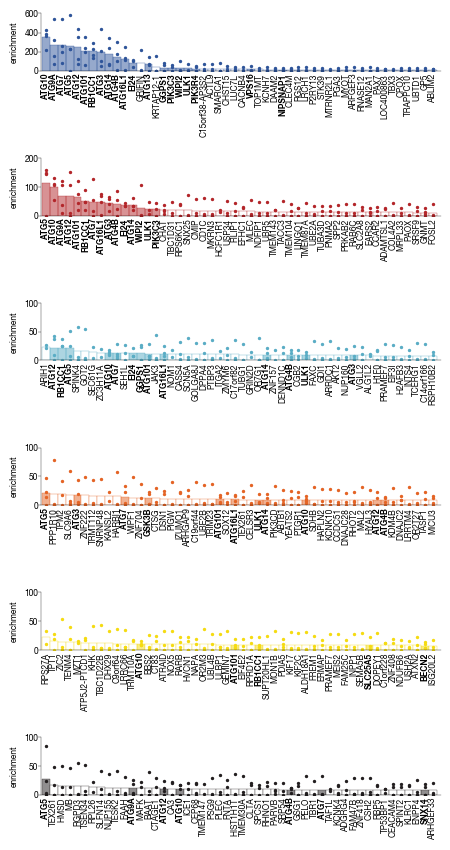

In [21]:
from matplotlib.colors import to_rgba

n_plots = len(["bin1", "bin2", "bin3", "bin4", "bin5", "bin6"])
colors = ['#2f559a', "#B3262A", "#5AADC5","#E46425", "#F5DB12",  "#231F20"]
colors_50per_alpha = [to_rgba(color, alpha = 0.5) for color in colors]
white = "#FFFFFF"

fig, axs = plt.subplots(n_plots,1, figsize = (118.5 * mm, 220 * mm), sharey = False,)
pivot_files = {}   

data_plots = None
sns.despine(offset = 0)

for i, _bin in enumerate(["bin1", "bin2", "bin3", "bin4", "bin5", "bin6"]):
    data = all_results.get(["gene", "gRNA_names", f"enrichment_{_bin}", "depleted_gene", f"ngRNAs_{_bin}"])
    data = data[data[f"ngRNAs_{_bin}"] >=2]
    data["gRNA_names"] = ["gRNA." + x.split(".")[1] for x in data["gRNA_names"]]
    
    _df = data.get(["gene"] + [x for x in data.columns if x.startswith("enrichment")])
    _df = _df.groupby("gene").mean()
    
    if data_plots is None:
        data_plots = _df
    else:
        data_plots = data_plots.merge(_df, left_index = True, right_index = True, how = "outer")
    
    _dat = data.drop(columns = "gRNA_names").groupby("gene").mean().sort_values(by = f"enrichment_{_bin}", ascending = False).head(50)

    labels = _dat.index.tolist()
    x = list(range(len(labels)))
    y = _dat[f"enrichment_{_bin}"]
    color = [colors_50per_alpha[i] if x in autophagy_genes_list else white for x in labels]
    
    pivot_data = data.pivot_table(index = "gene", values = f"enrichment_{_bin}", columns = 'gRNA_names')
    pivot_data = pivot_data.loc[labels].dropna(axis = 1, how = "all")
    
    pivot_files[_bin] = pivot_data
   
    axs[i].bar(x, y, align='center', color = color, width=1.0, edgecolor = colors[i], clip_on = True, linewidth=0.25)
    axs[i].set_xticks(ticks = x, labels = labels, rotation=90, ha='center');
    axs[i].tick_params(axis='both', which='major', labelsize=6, pad = 0, bottom = False)
    axs[i].tick_params(size = 2, width = 0.25)
    axs[i].spines["bottom"].set_linewidth(0.25)
    axs[i].spines["left"].set_linewidth(0.25)

    axs[i].set_ylabel("enrichment")
    
    axs[i].set_ylim(0, np.ceil(pivot_data.max().max()/100)*100)
    axs[i].set_xlim(-0.6,len(labels))

    for column in pivot_data.columns:
        y = pivot_data[column]
        axs[i].scatter(x, y, color = colors[i], s = 2, clip_on = True)
    
    axs[i].set_xticks(ticks = x, labels = labels, rotation=90, ha='center');
    #make those ticks that correspond to autophagy genes bold
    for label in axs[i].get_xticklabels() :
        if label.get_text() in autophagy_genes_list:
            font_prop = font_manager.FontProperties(weight = "bold", size = 6)
            label.set_fontproperties(font_prop)
    

fig.tight_layout()
fig.savefig("../plots/Screen_Analysis/enrichment_bins.pdf", transparent = False)

## Figure 4h

In [22]:
all_results = pd.read_csv("../data/Screen_Analysis/Raw_Data_Sequencing_Analysis_gRNA_count_table.csv", index_col = 0)
autophagy_genes_list = pd.read_csv("../data/Screen_Analysis/Raw_Data_Autophagy_Genes_list.txt", header = None)[0].tolist()

In [23]:
#get genes to plot for heatmaa
genes_df = all_results.get(["gene", "ngRNAs_normCountsfiltered_bin1", "ngRNAs_normCountsfiltered_bin2", "ngRNAs_normCountsfiltered_bin3", "ngRNAs_normCountsfiltered_bin4", "ngRNAs_normCountsfiltered_bin5", "ngRNAs_normCountsfiltered_bin6"]).set_index("gene")
genes_df = genes_df.loc[genes_df.index != "Non-Targeting Control", :]
genes_df  = genes_df[~(genes_df.index.duplicated())]
genes_df = genes_df.sum(axis = 1).sort_values(ascending=False)
genes_df_filtered = genes_df[genes_df >= 9].to_frame()
genes_df_filtered.columns = ["gRNA_count"]
genes_to_plot = genes_df_filtered.index.tolist()

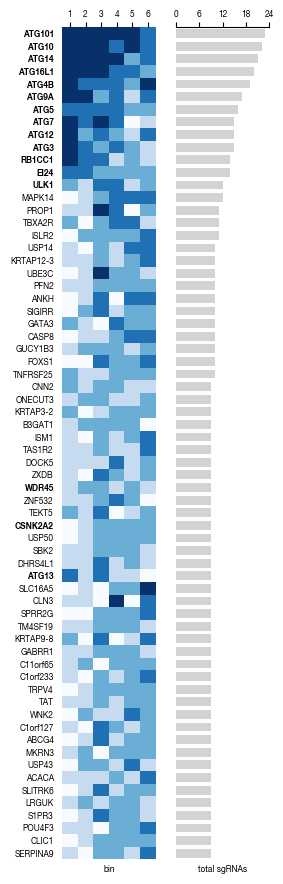

In [24]:
# heatmap visualization
results = pd.DataFrame(columns = ["gene", "bin1", "bin2", "bin3", "bin4", "bin5", "bin6"])

for i, gene in enumerate(genes_to_plot):
    _df = all_results[all_results.gene == gene]
    _df = (_df.get([x for x in _df.columns if x.startswith("ngRNAs_nor")])).iloc[0]
    
    results.loc[i, ["bin1", "bin2", "bin3", "bin4", "bin5", "bin6"]] = _df.values
    results.loc[i, "gene"] = gene

results = results.set_index("gene")
indexes = results.index.tolist()
indexes.reverse()
results = results.loc[indexes, :]

fig, axs = plt.subplots(1, 2, figsize=(3, 9))
sns.despine(left = True, bottom = True,ax = axs[0])
sns.despine(left = True, bottom = True, top = False, ax = axs[1])
axs[0].pcolormesh(results.values.astype("int"), cmap = "Blues", snap = True,)
axs[0].set(xlabel = "bin")

axs[0].set_yticks(np.array(range(len(results.index.tolist()))) + 0.5);
axs[0].set_yticklabels(results.index.tolist(), rotation = 0);
axs[0].set_xticks(np.array([0, 1,2, 3,4, 5]) + 0.5);
axs[0].set_xticklabels([1, 2, 3, 4, 5, 6]);

axs[0].tick_params(axis='both', which='major', labelsize=6, pad = 2.5, left = False)
axs[0].xaxis.set_ticks_position('top')

for label in axs[0].get_yticklabels() :
    if label.get_text() in autophagy_genes_list:
        font_prop = font_manager.FontProperties(weight = "bold", size = 6)
        label.set_fontproperties(font_prop)
    
width = 0.5
axs[1].barh(results.index.tolist(), results.sum(axis = 1), color = "#D1D3D4", height = 0.7)
axs[1].set_ylim(-0.5, len(results.index.tolist())-0.5)
axs[1].set_xlim(0, 24)
axs[1].set_xticks([0, 6, 12, 18, 24])
axs[1].set_xlabel("total sgRNAs")
axs[1].get_yaxis().set_visible(False)
axs[1].tick_params(axis='both', which='major', labelsize=6, pad = 2.5, left = False)
axs[1].xaxis.set_ticks_position('top')

fig.tight_layout()
fig.savefig("../plots/Screen_Analysis/heatmap_ngRNAS.pdf")

# Figure 5

## Figure 5a

 enrichment values were calulcated in python and the enrichment value mapped to respective HEX color. The figure was then generated manually in illustrator.

1.0 9.0


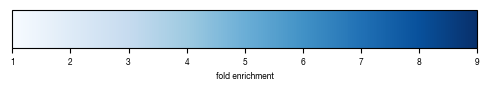

In [25]:
all_results = pd.read_csv("../data/Screen_Analysis/Raw_Data_Sequencing_Analysis_gRNA_count_table.csv", index_col = 0)
autophagy_genes_list = pd.read_csv("../data/Screen_Analysis/Raw_Data_Autophagy_Genes_list.txt", header = None)[0].tolist()

data_plots = None

for i, _bin in enumerate(["bin1", "bin2", "bin3", "bin4", "bin5", "bin6"]):
    data = all_results.get(["gene", "gRNA_names", f"enrichment_{_bin}", "depleted_gene", f"ngRNAs_{_bin}"])
    data = data[data[f"ngRNAs_{_bin}"] >=2]
    data["gRNA_names"] = ["gRNA." + x.split(".")[1] for x in data["gRNA_names"]]
    
    _df = data.get(["gene"] + [x for x in data.columns if x.startswith("enrichment")])
    _df = _df.groupby("gene").mean()
    
    if data_plots is None:
        data_plots = _df
    else:
        data_plots = data_plots.merge(_df, left_index = True, right_index = True, how = "outer")
    

_values = data_plots.max(axis = 1)

_to_export_kegg_plot = pd.DataFrame(_values)
_to_export_kegg_plot.columns = ["max_enrichment_bins"]
_to_export_kegg_plot["max_enrichment_bins"] = np.log2(_to_export_kegg_plot["max_enrichment_bins"])
_to_export_kegg_plot = _to_export_kegg_plot[_to_export_kegg_plot.max_enrichment_bins >= 1]

def map_to_hex(values, cmap = "Blues"):

    import matplotlib.cm as cm
    import matplotlib.colors as mpl_colors
    
    minima = np.floor(min(values))
    maxima = np.ceil(max(values))
    print(minima, maxima)

    norm = mpl_colors.Normalize(vmin=minima, vmax=maxima, clip=False)
    mapper = cm.ScalarMappable(norm=norm, cmap=cm.Blues)
    
    colors = [mapper.to_rgba(x) for x in values]
    colors = [mpl_colors.to_hex(x) for x in colors]
    

    fig, ax = plt.subplots(figsize=(6, 1))
    fig.subplots_adjust(bottom=0.5)


    cb1 = mpl.colorbar.ColorbarBase(ax, cmap=cm.Blues,
                                    norm=norm,
                                    orientation='horizontal')
    cb1.set_label("fold enrichment")
    fig.savefig("colorbar_KEGG_enrichment.pdf")
    fig.show()

    return(colors)

_to_export_kegg_plot["color"] = map_to_hex(_to_export_kegg_plot.max_enrichment_bins)
_to_export_kegg_plot = _to_export_kegg_plot.get(["color", "max_enrichment_bins"])
_to_export_kegg_plot.to_csv("../data/Screen_Analysis/Raw_Data_enrichment_values_genes_autopahgy_pathway.tsv", sep = "\t")

## Figure 5b

annotated gene labels were shifted in illustrator for better visibility


In [26]:
all_results = pd.read_csv("../data/Screen_Analysis/Raw_Data_Sequencing_Analysis_gRNA_count_table.csv", index_col = 0)
autophagy_genes_list = pd.read_csv("../data/Screen_Analysis/Raw_Data_Autophagy_Genes_list.txt", header = None)[0].tolist()

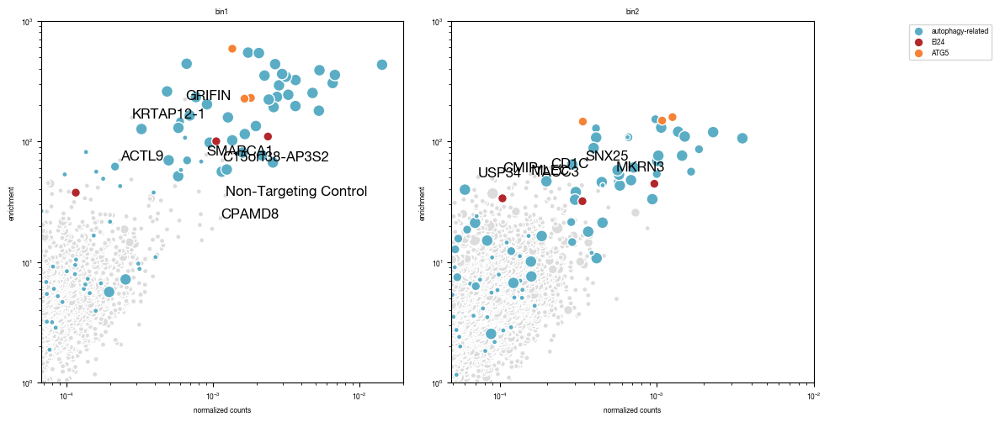

In [27]:
#define size of circles to plot
def scale_circle_size(input):
    lookup = {2:20,
              3:60,
              4:100}
    for key in lookup.keys():
        input = input.replace(key, lookup[key])
    return(input)


fig, axs = plt.subplots(1, 2, figsize = (12, 6))

for i, _bin in enumerate(["bin1", "bin2"]):
 

    df = all_results[all_results["ngRNAs_"+_bin] >= 2] #only plot genes were we found at least 2 gRNAs
    df = df.set_index("gene")
    df.loc["Non-Targeting Control",f"ngRNAs_{_bin}" ] = 2 #manually set NTC gRNA numbre to 2 otherwise we would get very large dots for this
    df = df.replace(0, np.NaN)
    
    #dynamically adjust x and y-axis limits according to data
    ymin = df.get(f"enrichment_{_bin}").min()
    ymax = df.get(f"enrichment_{_bin}").max()
    xmin = df.get(f"normCounts_{_bin}").min()
    xmax = df.get(f"normCounts_{_bin}").max()
    axs[i].set_ylim(1, np.ceil(ymax/1000)*1000)
    axs[i].set_xlim(np.floor(xmin/0.000001)*0.000001, np.ceil(xmax/0.01)*0.01)
    
    #get autophagy genes to plot 
    autophagy_genes_list_plot = [x for x in autophagy_genes_list if x != "EI24"] #filter to remove EI24 since we will visualize in different color
    autophagy_genes_list_plot = [x for x in autophagy_genes_list_plot if x != "ATG5"] #filter to remove ATG5 since we will visualize in different color
    _autophagy_genes = [x for x in autophagy_genes_list_plot if x in df.index.tolist()]
    
    #subset data into non-autophagy related genes and autophagy-related genes
    df2 = df.loc[_autophagy_genes, :]
    df1 = df.loc[[x not in _autophagy_genes+["EI24"] for x in df.index.tolist()], :]

    axs[i].scatter(df1.get('normCounts_' + _bin), df1.get('enrichment_' + _bin), s = scale_circle_size(df1.get(f"ngRNAs_{_bin}")), color = "gainsboro", edgecolor = "white")
    axs[i].scatter(df2.get('normCounts_' + _bin), df2.get('enrichment_' + _bin), s = scale_circle_size(df2.get(f"ngRNAs_{_bin}")), color = "#5AADC5", label = "autophagy-related", edgecolor = "white")
    
    if "EI24" in df.index.tolist():
        df3 = df.loc["EI24"]
        axs[i].scatter(df3.get('normCounts_' + _bin), df3.get('enrichment_' + _bin), s = scale_circle_size(df3.get(f"ngRNAs_{_bin}")), color = "#B3262A", label = "EI24", edgecolor = "white")
    if "ATG5" in df.index.tolist():
        df4 = df.loc["ATG5"]
        axs[i].scatter(df4.get('normCounts_' + _bin), df4.get('enrichment_' + _bin), s = scale_circle_size(df4.get(f"ngRNAs_{_bin}")), color = "#F58235", label = "ATG5", edgecolor = "white")
        
    #add annotation
    df_annotate_write_out = df[np.array([df[f"enrichment_{_bin}"] >= 40, df[f"normCounts_{_bin}"] >= 0.0005]).T.any(axis = 1).tolist()].get([f"normCounts_{_bin}", f"enrichment_{_bin}"])
    df_annotate_write_out = df_annotate_write_out.loc[[x for x in df_annotate_write_out.index.tolist() if x not in autophagy_genes_list]]
    df_annotate_write_out.to_csv(f"gene_annotation_enrichment_normCount_scatter_plot_{_bin}.tsv")
    
    df_annotate = df[np.array([df[f"enrichment_{_bin}"] >= 50, df[f"normCounts_{_bin}"] >= 0.001]).T.any(axis = 1).tolist()]
    labels = df_annotate.index.tolist()
    labels = [x for x in labels if x not in autophagy_genes_list]
    df_annotate = df_annotate.loc[labels, :]
    
    x = df_annotate[f"normCounts_{_bin}"].tolist()
    y = df_annotate[f"enrichment_{_bin}"].tolist()
    
    for ix, txt in enumerate(labels):
        axs[i].annotate(txt, (x[ix], y[ix]) )
    
    axs[i].set_xlabel("normalized counts")
    axs[i].set_ylabel("enrichment")
    axs[i].set_xscale("log")
    axs[i].set_yscale("log")
    axs[i].set_title(_bin)
    axs[i].set_aspect(1.0/axs[i].get_data_ratio(), adjustable='box')
    
    if i == 1:
        axs[i].legend(bbox_to_anchor=(1.5, 1))
        
fig.tight_layout()
fig.savefig("../plots/Screen_Analysis/scatterplot_gRNAs_enrichment_normcounts.pdf")

## Figure 5d

In [28]:
#load saved data
data = pd.read_csv("../data/Raw_Data_EI24_timecourse_experiment.csv", index_col = 0)

#groupby condition and calculate the mean for each replicate over all cells
plot = data.get(["replicate", "Genotype", "Condition", "time", "Prob_Unstim"])
plot = plot.groupby(["replicate", "Genotype", "Condition", "time"]).mean().reset_index()
plot.columns = ["replicate", "Genotype", "label", "time", "Mean"]

In [29]:
plot

,replicate,Genotype,label,time,Mean
0,0,EI24KO_1,0d,0,0.943735
1,0,EI24KO_1,10h,10,0.795733
2,0,EI24KO_1,12h,12,0.767672
3,0,EI24KO_1,14h,14,0.758736
4,0,EI24KO_1,2h,2,0.898793
...,...,...,...,...,...
91,2,WT_2,14h,14,0.190480
92,2,WT_2,2h,2,0.927715
93,2,WT_2,4h,4,0.775990
94,2,WT_2,6h,6,0.474953


In [30]:
#load saved data
data = pd.read_csv("../data/Raw_Data_EI24_timecourse_experiment.csv", index_col = 0)

#groupby condition and calculate the mean for each replicate over all cells
plot = data.get(["replicate", "Genotype", "Condition", "time", "Prob_Unstim"])
plot = plot.groupby(["replicate", "Genotype", "Condition", "time"]).mean().reset_index()
plot.columns = ["replicate", "Genotype", "label", "time", "Mean"]

# calculate the mean and SEM over the 3 biological replicates
plot2 = plot.get(["Genotype", "time", "Mean"]).groupby(["Genotype", "time"]).mean().get("Mean").to_frame()
plot2["Sem"] = plot.get(["Genotype", "time", "Mean"]).groupby(["Genotype", "time"]).sem().get("Mean")
plot2 = plot2.reset_index()

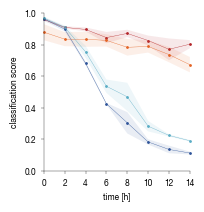

In [31]:
genotype_color = {"WT_1":"#2F559A",
                  "WT_2":"#5AADC5",
                  'EI24KO_1':"#B3262A", 
                  'EI24KO_2':"#E46425",
                 }


fig, axs = plt.subplots(1, 1, figsize = (56*mm, 58*mm))
sns.despine()

for genotype in plot.Genotype.value_counts().index:
    _data = plot2[plot2.Genotype == genotype]
    _data = _data.sort_values("time")
    axs.scatter(_data.time, _data.Mean, color = genotype_color[genotype], clip_on = False, s = 1)
    axs.plot(_data.time, _data.Mean, color = genotype_color[genotype], label = genotype, linewidth = 0.25)
    lower = _data.Mean - _data.Sem
    upper = _data.Mean + _data.Sem
    axs.fill_between(_data.time, lower , upper, color = genotype_color[genotype], edgecolors = None, alpha = 0.1)

axs.set_ylim(0, 1)
axs.set_xlim(0, 14)
axs.set_ylabel("classification score", fontsize = 6)
axs.set_xlabel("time [h]", fontsize = 6)

axs.tick_params(axis='both', which='major', labelsize=6, size = 2, width = 0.25)
axs.spines["bottom"].set_linewidth(0.25)
axs.spines["left"].set_linewidth(0.25)

axs.set_xticks([0, 2, 4, 6, 8, 10, 12, 14])

fig.tight_layout()
fig.savefig("../plots/EI24_timecourse.pdf")

## Figure 5e

scale bars and arrows indicating specks were added manually in illustrator

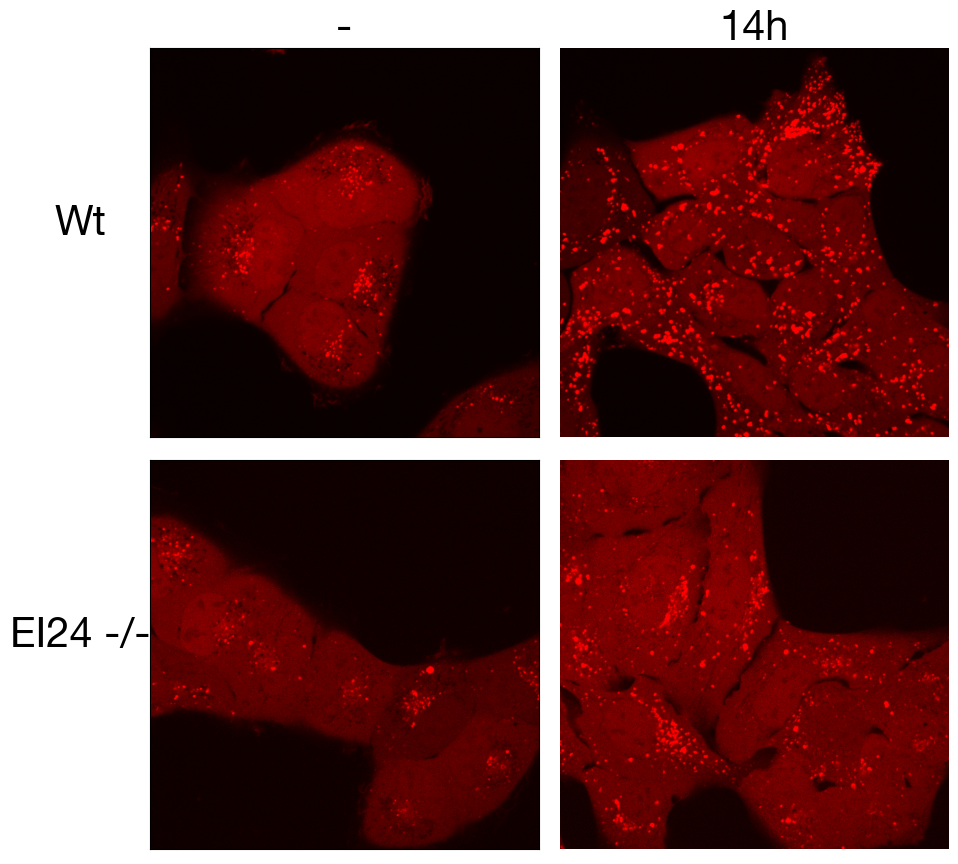

In [32]:
from tifffile import imread

def colorize(im, color, clip_percentile=0.0):
    """
    Helper function to create an RGB image from a single-channel image using a 
    specific color.
    """
    # Check that we do just have a 2D image
    if im.ndim > 2 and im.shape[2] != 1:
        raise ValueError('This function expects a single-channel image!')
        
    # Rescale the image according to how we want to display it
    im_scaled = im.astype(np.float32) - np.percentile(im, clip_percentile)
    im_scaled = im_scaled / np.percentile(im_scaled, 100 - clip_percentile)
    im_scaled = np.clip(im_scaled, 0, 1)
    
    # Need to make sure we have a channels dimension for the multiplication to work
    im_scaled = np.atleast_3d(im_scaled)
    
    # Reshape the color (here, we assume channels last)
    color = np.asarray(color).reshape((1, 1, -1))
    return im_scaled * color

fig, axs = plt.subplots(2, 2, figsize = (10, 8.8))

axs[0, 0].imshow(colorize(imread("../data/example_images_100X_EI24_imaging/230224_U2OS_EI24_wt_Torin_0h.tif"), color = (1, 0, 0)))
axs[0, 0].xaxis.set_visible(False)
axs[0, 0].tick_params(left=False, labelleft=False)
axs[0, 0].set_title("-", fontsize = 30)
axs[0, 0].set_ylabel("Wt", rotation = 0, fontsize = 30, labelpad = 50)

axs[0, 1].imshow(colorize(imread("../data/example_images_100X_EI24_imaging/230224_U2OS_EI24_wt_Torin_14h.tif"), color = (1, 0, 0)))
axs[0, 1].axis("off")
axs[0, 1].set_title("14h", fontsize = 30)

axs[1, 0].imshow(colorize(imread("../data/example_images_100X_EI24_imaging/230224_U2OS_EI24_KO_Torin_0h.tif"), color = (1, 0, 0)))
axs[1, 0].xaxis.set_visible(False)
axs[1, 0].tick_params(left=False, labelleft=False)
axs[1, 0].set_ylabel("EI24 -/-", rotation = 0, fontsize = 30, labelpad = 50)

axs[1, 1].imshow(colorize(imread("../data/example_images_100X_EI24_imaging/230224_U2OS_EI24_KO_Torin_14h.tif"), color = (1, 0, 0)))
axs[1, 1].axis("off")

fig.tight_layout()

fig.savefig("../plots/EI24_100X_images.pdf")

# Extended Data Figure 1

# Extended Data Figure 2

## Extended Data Figure 2b

/tmp/ipykernel_1703410/160588194.py:16: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/tmp/ipykernel_1703410/160588194.py:16: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



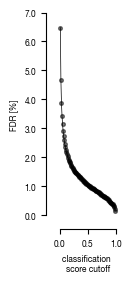

In [33]:
subsampled_classification_results = pd.read_csv("../data/Raw_Data_classifier_metrics_classifier_1.0.csv")
versions = ["classifier_1.0"]

thresholds = np.linspace(0.01, 0.99, 100)
labels = ["stim", "ATG5_KO_Cr203_C6"]

color1 = "black"

for version in versions:
    results = pd.DataFrame(index = thresholds)

    data = subsampled_classification_results.loc[[x in labels for x in subsampled_classification_results.label]].get([version, "label"])
    data["label"] = ["negative" if x == "stim" else "positive" for x in data.label]

    for _threshold in thresholds:
        data[f"label_{_threshold}"] = ["positive" if x > _threshold else "negative" for x in data[version]]

    #precision = TP / (TP + FP)

    for _threshold in thresholds:
        true_label = data.label.tolist()
        label = data[f"label_{_threshold}"].tolist()

        TP = 0
        FP = 0
        TN = 0
        FN = 0

        for tl, l in zip(true_label, label):
            if tl == "positive":
                if l == "positive":
                    TP += 1
                elif l == "negative":
                    FN += 1
                else:
                    print("Error")

            elif tl == "negative":
                if l == "positive":
                    FP += 1
                elif l == "negative":
                    TN += 1
            else:
                print("error")

        precision = TP / (TP + FP) * 100
        recall = TP / (TP + FN) * 100
        accuracy = (TP + TN) / (TP + FP + TN + FN) * 100
        FPR = FP / (FP + TN) * 100
        FDR = FP / (FP + TP) * 100

        results.loc[_threshold, "TP"] = TP
        results.loc[_threshold, "FP"] = FP
        results.loc[_threshold, "TN"] = TN
        results.loc[_threshold, "FN"] = FN
        results.loc[_threshold, "precision"] = precision
        results.loc[_threshold, "recall"] = recall
        results.loc[_threshold, "accuracy"] = accuracy
        results.loc[_threshold, "FPR"] = FPR
        results.loc[_threshold, "FDR"] = FDR
    
    results.to_csv(f"../data/{version}_Test_Data/{version}_FDR_data.csv")
    
    fig, axs = plt.subplots(1, 1, figsize = (1.5, 3))

    sns.despine(offset = 10)
    axs.plot(results.index.tolist(), results.FDR.tolist(), clip_on = False, linewidth = 0.5, color = color1)
    axs.scatter(x = results.index.tolist(), y = results.FDR.tolist(), clip_on = False, alpha = 0.5, s = 7, color = color1)
    axs.set_ylabel("FDR [%]", color = color1, fontsize = 6)
    axs.set_xlabel("classification \nscore cutoff", fontsize = 6)
    axs.set_xlim(0, 1)

    if version == 'classifier_1.0':
        axs.set_ylim(0, 7)

    axs.yaxis.set_major_formatter(FormatStrFormatter('%.1f'))

    fig.tight_layout()
    fig.savefig(f"../plots/{version}/{version}_FDR.pdf",  bbox_inches='tight')


## Extended Data Figure 2c


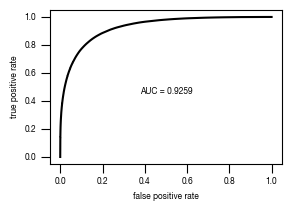

In [34]:
#load previously saved data
subsampled_classification_results = pd.read_csv("../data/Raw_Data_classifier_metrics_classifier_1.0.csv")
versions = ["classifier_1.0"]

from sklearn.metrics import precision_recall_curve, roc_curve, auc
labels = ["stim", "ATG5_KO_Cr203_C6"]

results_all = {}
auc_values = {}

for version in versions:
    data = subsampled_classification_results.loc[[x in labels for x in subsampled_classification_results.label]].get([version, "label"])
    true_label = [0 if x == "stim" else 1 for x in data.label]
    scores = data[version].tolist()
    
    fpr, tpr, thresholds = roc_curve(true_label, scores)
    precision, recall, thresholds = precision_recall_curve(true_label, scores)
    fdr = 1 - precision
    
    auc_roc = auc(fpr, tpr)
    auc_precision_recall = auc(recall, precision)
    auc_values[version] = pd.DataFrame({"ROC":[auc_roc], "precision_recall":[auc_precision_recall]})
    
    fig, axs = plt.subplots(1, 1, figsize = (3, 2))
    axs.plot(fpr, tpr, color = "black")
    axs.set_xlabel("false positive rate")
    axs.set_ylabel("true positive rate")
    axs.tick_params(axis='both', which='major', labelsize=6, size = 3.5*1.773)
    auc_results = "{0:.4g}".format(auc_values[version].ROC[0])
    axs.text(x = 0.5, y= 0.45, s= f"AUC = {auc_results}", fontsize = 6, horizontalalignment= "center")
    fig.savefig(f"../plots/{version}/{version}_tpr_fpr_curve.pdf")

## Extended Data Figure 2d

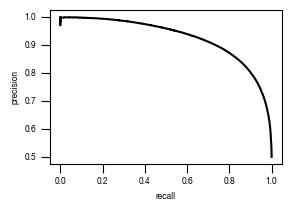

In [35]:
#load previously saved data
subsampled_classification_results = pd.read_csv("../data/Raw_Data_classifier_metrics_classifier_1.0.csv")
versions = ["classifier_1.0"]

from sklearn.metrics import precision_recall_curve, roc_curve, auc
labels = ["stim", "ATG5_KO_Cr203_C6"]

results_all = {}
auc_values = {}

for version in versions:
    data = subsampled_classification_results.loc[[x in labels for x in subsampled_classification_results.label]].get([version, "label"])
    true_label = [0 if x == "stim" else 1 for x in data.label]
    scores = data[version].tolist()
    
    fpr, tpr, thresholds = roc_curve(true_label, scores)
    precision, recall, thresholds = precision_recall_curve(true_label, scores)
    fdr = 1 - precision
    
    auc_roc = auc(fpr, tpr)
    auc_precision_recall = auc(recall, precision)
    auc_values[version] = pd.DataFrame({"ROC":[auc_roc], "precision_recall":[auc_precision_recall]})
    
    fig, axs = plt.subplots(1, 1, figsize = (3, 2))
    axs.plot(recall, precision, color = "black")
    axs.set_xlabel("recall")
    axs.set_ylabel("precision")
    axs.tick_params(axis='both', which='major', labelsize=6, size = 3.5*1.773)
    fig.savefig(f"../plots/{version}/{version}_precision_recall_curve.pdf")

## Extended Data Figure 2e

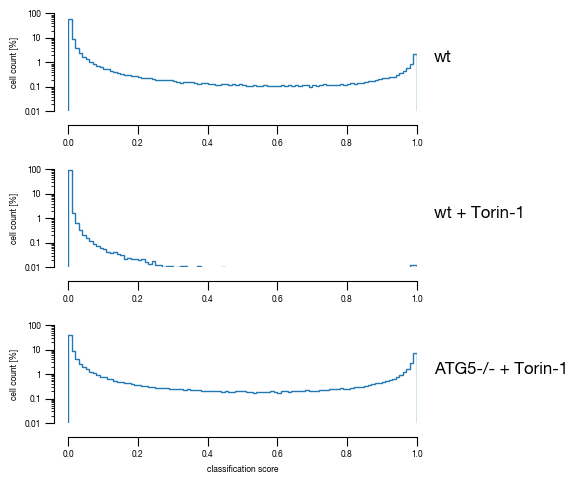

In [36]:
#load previously saved data
subsampled_classification_results = pd.read_csv("../data/Raw_Data_classifier_metrics_classifier_1.0.csv")
versions = ["classifier_1.0"]

slides = ["unstim", "stim", "ATG5_KO_Cr203_C6"]
labels = ["wt", "wt + Torin-1", "ATG5-/- + Torin-1"]

from matplotlib.ticker import FormatStrFormatter

for version in versions:

    fig, axs = plt.subplots(3, 1, figsize = (6, 5), sharey = True)
    sns.despine(offset = 10)

    for i, slide in enumerate(slides):
        data = subsampled_classification_results.loc[[x == slide for x in subsampled_classification_results.label]].get([version])
        hist = axs[i].hist(data, bins = 100, cumulative = False, histtype='step', bottom = 0, weights = np.ones(len(data)) / len(data)*100)
        axs[i].set_ylim(0.01, 100)
        axs[i].set_yscale("log")
        axs[i].set_xlim(0, 1)
        axs[i].yaxis.set_major_formatter(FormatStrFormatter('%.3g'))

        axs[i].set_ylabel("cell count [%]")
        axs[i].tick_params(size = 3.5*1.773)
       
        axs[i].text(1.05, 1, s = labels[i])

    axs[i].set_xlabel("classification score")
    fig.tight_layout()
    fig.savefig(f"../plots/{version}/{version}_Histogram_classifier_performance_lines.pdf", bbox_inches='tight')

## Extended Data Figure 2f

/tmp/ipykernel_1703410/2450281620.py:49: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



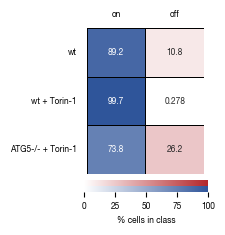

In [37]:
#load previously saved data
subsampled_classification_results = pd.read_csv("../data/Raw_Data_classifier_metrics_classifier_1.0.csv")
versions = ["classifier_1.0"]

sample_label_lookup = {"unstim":"wt", "stim":"wt + Torin-1", "ATG5_KO_Cr203_C6":"ATG5-/- + Torin-1"}
n_cells = subsampled_classification_results.label.value_counts()[0]

for version in versions:
    _df = subsampled_classification_results.copy()
    _df["threshold_label"] = _df[version] >= 0.5    
    
    heatmap_data = pd.DataFrame(_df.groupby("label").sum().threshold_label/n_cells*100)
    heatmap_data.columns = ["unstimulated"]
    heatmap_data["stimulated"] = 100 - heatmap_data.unstimulated

    fig, axs = plt.subplots(1, 2, figsize = (2.3,2), sharex=False, sharey=True, gridspec_kw = {'wspace':0, 'hspace':0})
    
    cbar_ax1 = fig.add_axes([0.4, 0, 0.54, 0.03])
    cbar_ax2 = fig.add_axes([0.4, 0.03, 0.54, 0.03])
    
    sns.heatmap(heatmap_data.stimulated.to_frame().sort_index(ascending= False), annot = True, ax = axs[0], 
                cmap= cmap_stim, cbar_kws={'label': '% cells in class', "orientation": "horizontal"}, fmt = ".3g", vmax=100, vmin = 0, cbar_ax=cbar_ax1, 
                linewidths=0.5, linecolor='black',
                annot_kws={"size": 6})
    sns.heatmap(heatmap_data.unstimulated.to_frame().sort_index(ascending= False), annot = True, ax = axs[1], 
                cmap= cmap_unstim, cbar_kws={ "orientation": "horizontal"}, fmt = ".3g", vmax=100, vmin = 0, cbar_ax=cbar_ax2, 
                linewidths=0.5, linecolor='black', 
                annot_kws={"size": 6})
    
    #remove axis from second colorbar
    cbar_ax2.axis("off")
    
    #reassign labels into readable format
    labels = [sample_label_lookup[item.get_text()] for item in axs[0].get_yticklabels()]
    axs[0].set_yticklabels(labels)
    axs[0].set_xticklabels(["on"])
    axs[1].set_xticklabels(["off"])

    #move x-axis ticks to top and remove ticks
    axs[0].xaxis.set_ticks_position('top')
    axs[1].xaxis.set_ticks_position('top')
    axs[0].tick_params(left=False, top=False, bottom = False, rotation = 0)
    axs[1].tick_params(left=False, top=False, bottom = False, rotation = 0)
    
    #remove ylabel
    axs[0].set_ylabel(None)
    axs[1].set_ylabel(None)
    
    fig.tight_layout()
    fig.savefig(f"../plots/{version}/{version}_heatmap.pdf", bbox_inches='tight')

## Extended Data Figure 2g

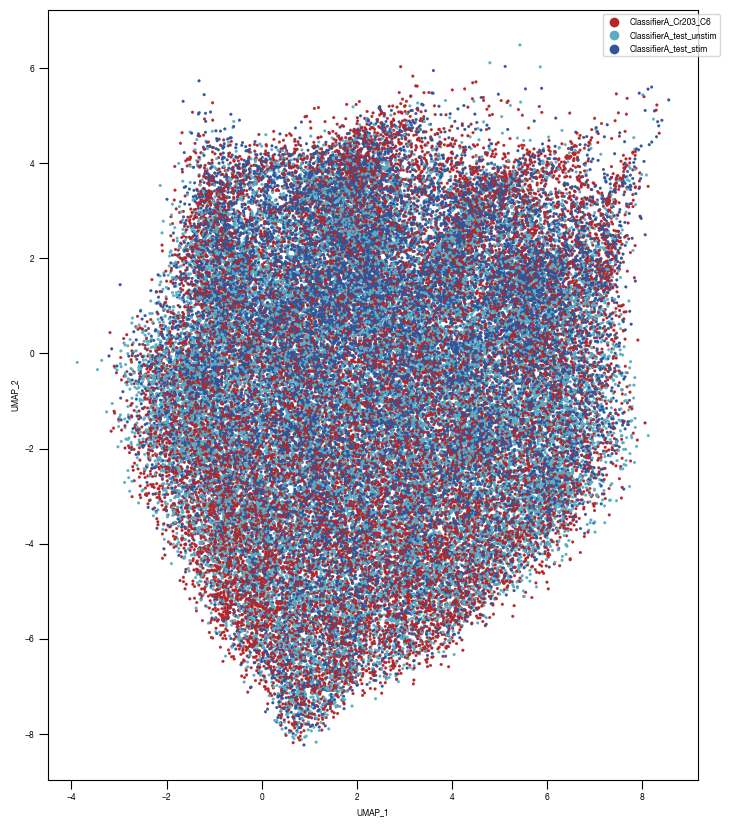

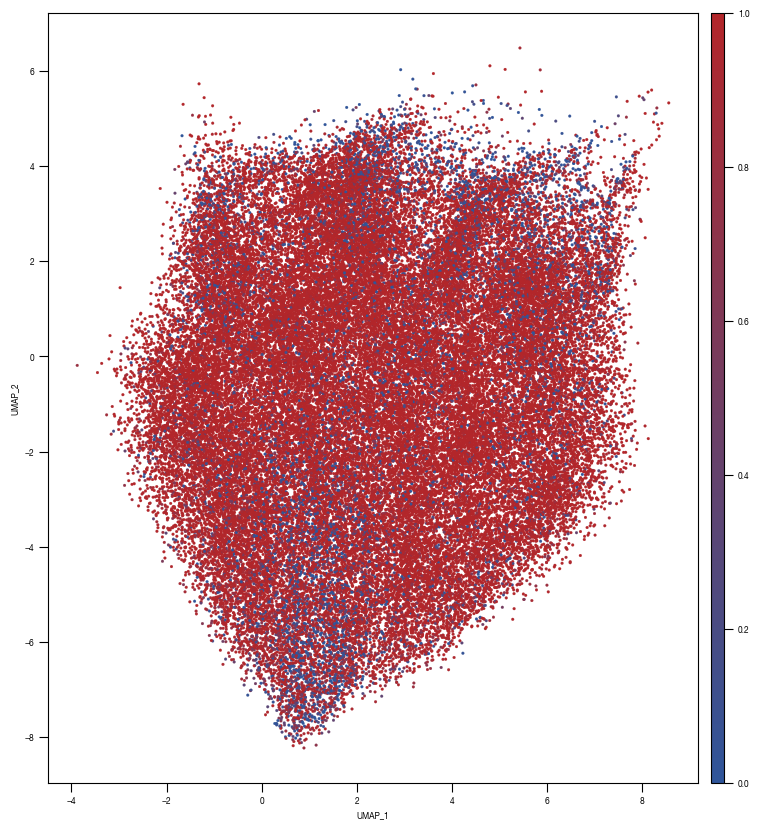

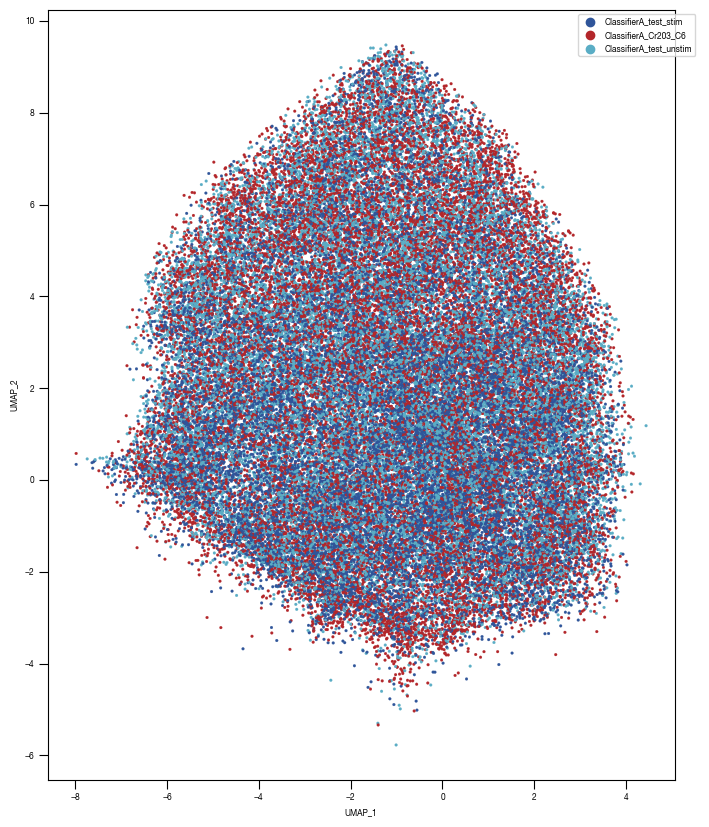

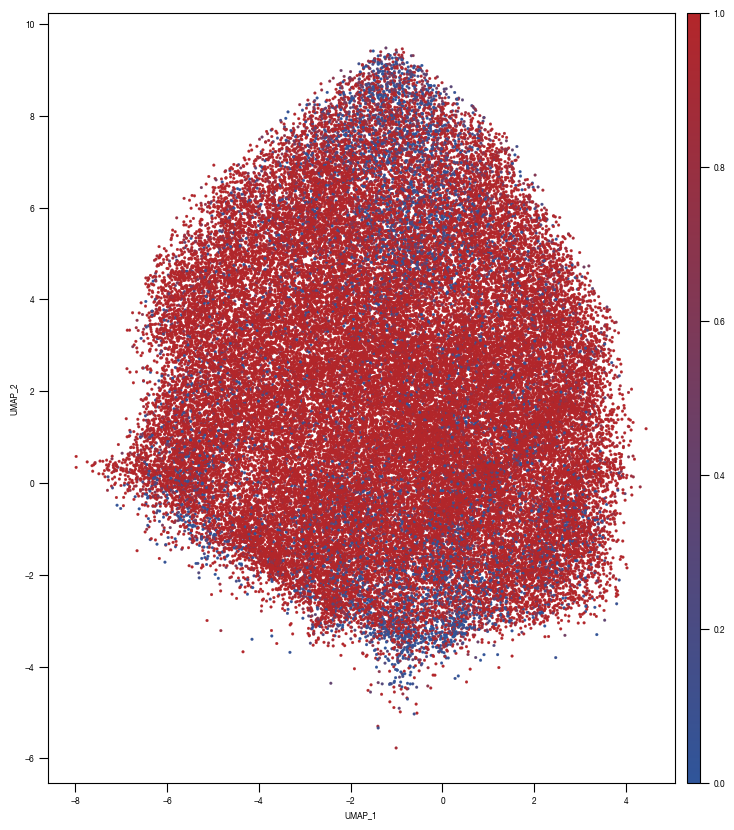

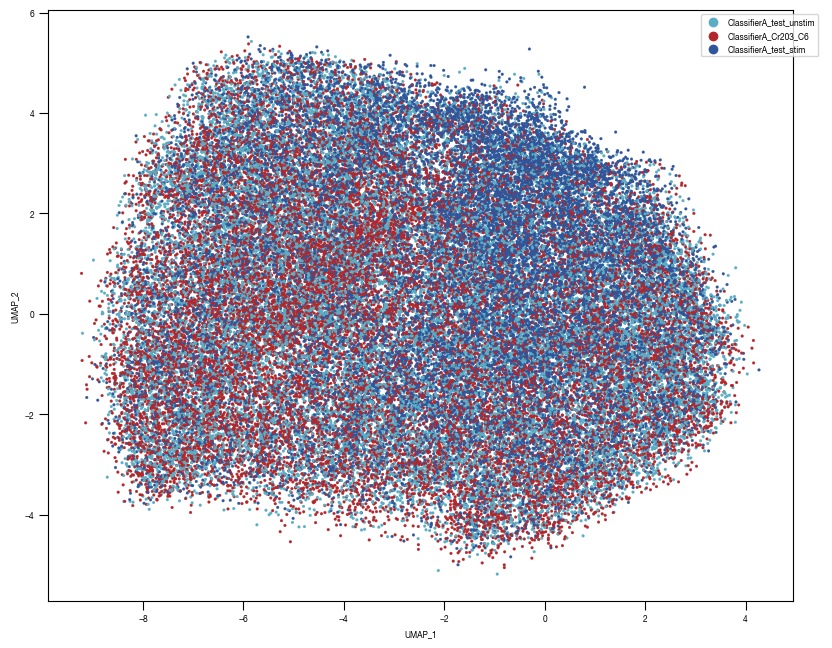

...

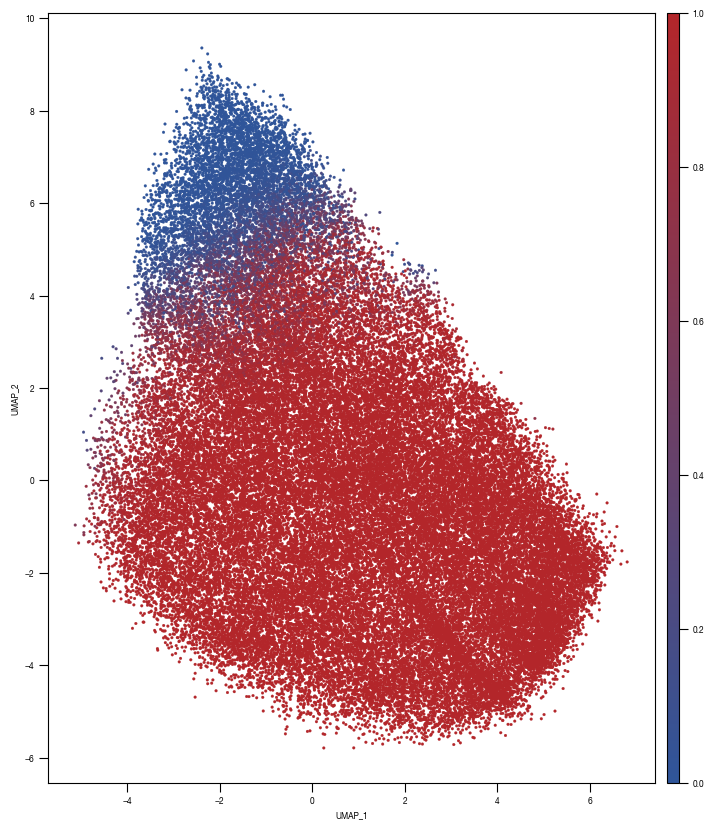

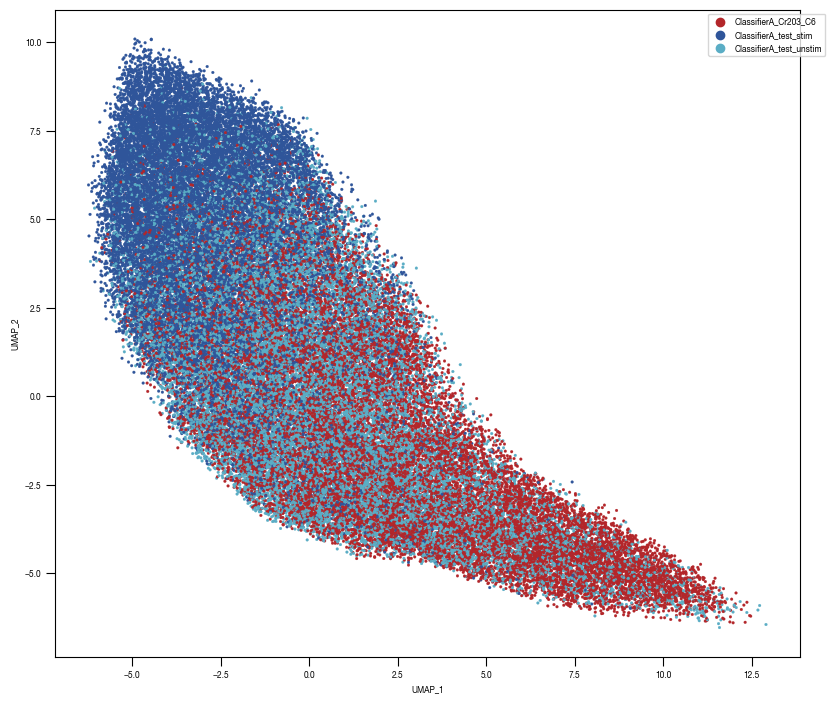

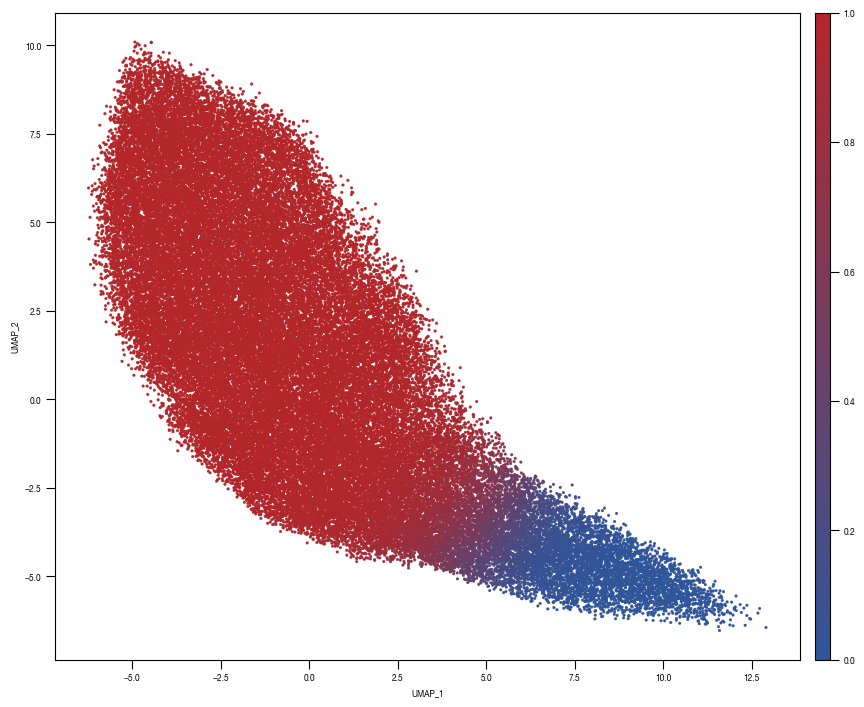

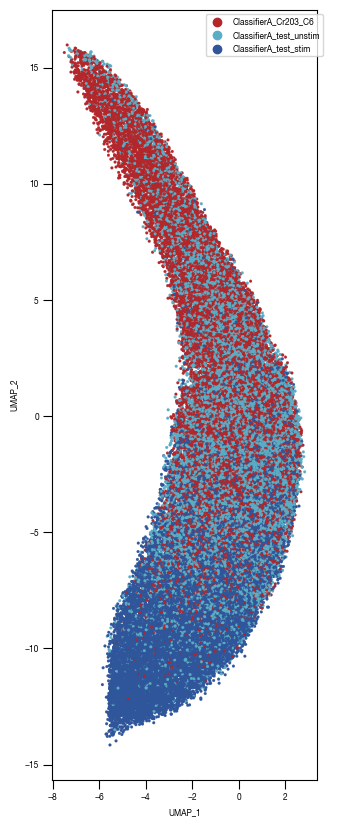

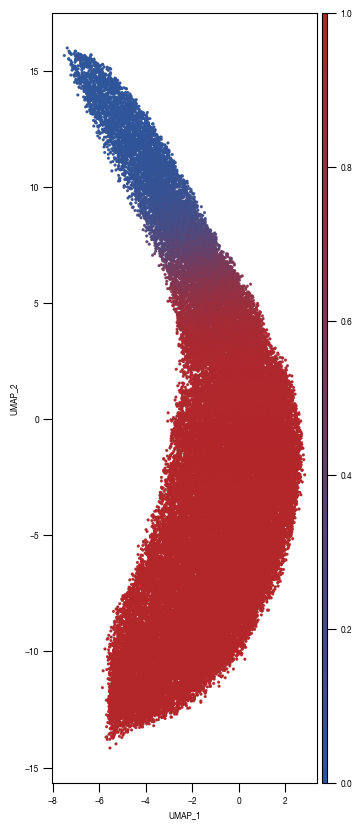

In [38]:
layers = ["conv2d5", "conv2d6", "conv2d7","conv2d8","conv2d9", "linear1", "linear2", ]

for layer in layers: 
        
    input = f"../data/classifier_1.0_Test_Data/UMAP_data/Raw_data_UMAP_{layer}.csv"
    df_train_umap = pd.read_csv(input)

    outdir = f"../plots/UMAP_classifier1.0_layers/"
    
    ### Plot 1 Labels
    fig, axs = plt.subplots(1, 1, figsize = (10, 10))
    
    
    color_dict = dict({'ClassifierA_Cr203_C6':"#B3262A",
                       "ClassifierA_test_stim":'#2f559a',
                       "ClassifierA_test_unstim":"#5AADC5", 
                      })
    
    ax = sns.scatterplot(df_train_umap.sample(frac=1, random_state = 19),  x = "UMAP_1", y = "UMAP_2", s = 4, hue = "class_label", alpha = 1, palette = color_dict, ax = axs, edgecolor = None, rasterized=True)
    axs.tick_params(size = 3.5*1.773)

    legend = ax.get_legend()
    ax.get_legend().remove()

    ax1_divider = make_axes_locatable(ax)
    cax1 = ax1_divider.append_axes("right", size="2%", pad="2%")
    cax1.axis("off")
    cax1.legend(*ax.get_legend_handles_labels(), bbox_to_anchor = (1, 1))
    
    ax.set_aspect('equal', adjustable='box')
    # fig.tight_layout()
    fig.savefig(f"{outdir}/UMAP_test_data_labels_{layer}.pdf", dpi = 500)

    ### PLOT 2: prob unstim
    fig, axs = plt.subplots(1, 1, figsize = (10, 10))
    
    ax = sns.scatterplot(data = df_train_umap.sample(frac=1, random_state = 19),  x = "UMAP_1", y = "UMAP_2", s = 4, hue = "prob_unstim", alpha = 1, ax = axs, palette=cmap_classification_score, edgecolor = None, rasterized = True)
    axs.tick_params(size = 3.5*1.773)

    norm = plt.Normalize(0, 1)
    sm = plt.cm.ScalarMappable(cmap=cmap_classification_score, norm=norm)
    sm.set_array([])

    # Remove the legend and add a colorbar
    ax.get_legend().remove()

    ax1_divider = make_axes_locatable(ax)
    cax1 = ax1_divider.append_axes("right", size="2%", pad="2%")
    cb1 = fig.colorbar(sm, cax=cax1)
    cax1.tick_params(size = 3.5*1.773)
    
    ax.set_aspect('equal', adjustable='box')
    fig.savefig(f"{outdir}/UMAP_test_data_prob_unstim_{layer}.pdf", dpi = 500)

## Extended Data Figure 2h

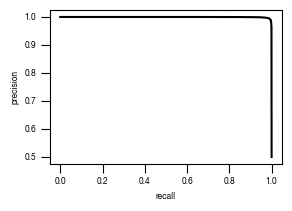

In [39]:
#load previously saved data
subsampled_classification_results = pd.read_csv("../data/T02_Raw_Data_classifier_metrics_classifier_2.0_2.1.csv")
versions = ["classifier_2.0"]

from sklearn.metrics import precision_recall_curve, roc_curve, auc
labels = ["stim", "ATG5_KO_Cr203_C6"]

results_all = {}
auc_values = {}

for version in versions:
    data = subsampled_classification_results.loc[[x in labels for x in subsampled_classification_results.label]].get([version, "label"])
    true_label = [0 if x == "stim" else 1 for x in data.label]
    scores = data[version].tolist()
    
    fpr, tpr, thresholds = roc_curve(true_label, scores)
    precision, recall, thresholds = precision_recall_curve(true_label, scores)
    fdr = 1 - precision
    
    auc_roc = auc(fpr, tpr)
    auc_precision_recall = auc(recall, precision)
    auc_values[version] = pd.DataFrame({"ROC":[auc_roc], "precision_recall":[auc_precision_recall]})
    
    fig, axs = plt.subplots(1, 1, figsize = (3, 2))
    axs.plot(recall, precision, color = "black")
    axs.set_xlabel("recall")
    axs.set_ylabel("precision")
    axs.tick_params(axis='both', which='major', labelsize=6, size = 3.5*1.773)
    fig.savefig(f"../plots/{version}/T02_{version}_precision_recall_curve.pdf")

# Extended Data Figure 3

## Extended Data Figure 3a

Tables were formatted in illustrator

In [40]:
# left table

pd.read_csv("../data/Screen_Analysis/screen_batches/ScreenB1_aggregated_results_number_of_cells_per_bin.csv")

,Unnamed: 0,cells imaged,cells dissected,percentage_of_all_cells
0,bin1,937,795.0,0.016915
1,bin2,10794,9113.0,0.194861
2,bin3,5021,4387.0,0.090643
3,bin4,4540,3968.0,0.081959
4,bin5,4839,4270.0,0.087357
5,bin6,5121,4525.0,0.092448
6,cells >= 0.98,31252,27058.0,0.564183
7,all_imaged_cells,5539333,NaN,100.000000


In [41]:
# right table

pd.read_csv("../data/Screen_Analysis/screen_batches/ScreenB2_aggregated_results_number_of_cells_per_bin.csv")

,Unnamed: 0,cells imaged,cells dissected,percentage_of_all_cells
0,bin1,19516,14009.0,0.056883
1,bin2,217766,179898.0,0.634718
2,bin3,74672,52283.0,0.217645
3,bin4,56478,41061.0,0.164615
4,bin5,55477,41695.0,0.161698
5,bin6,56102,43189.0,0.163519
6,cells >= 0.98,480011,372135.0,1.399078
7,all_imaged_cells,34309090,NaN,100.000000


## Extended Data Figure 3b

slide names were rmoved and the slide batches annotated manually in illustrator

In [42]:
_df1 = pd.read_parquet("../data/Screen_Analysis/screen_batches/ScreenB1_raw_data_cell_classification_values_with_bin_annotation.parquet")
_df2 = pd.read_parquet("../data/Screen_Analysis/screen_batches/ScreenB2_raw_data_cell_classification_values_with_bin_annotation.parquet")

all_results = pd.concat([_df1, _df2])

In [43]:
all_results = all_results.get(["slide", "Prob_Unstim"])
data_cell_counts = all_results.groupby("slide").count()
data_cell_counts.columns = ["number_of_cells_per_slide"]

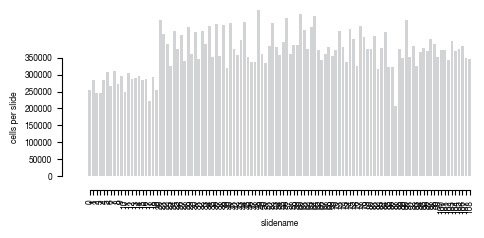

In [44]:
fig, axs = plt.subplots(1,1, figsize = (5, 3))
sns.despine(offset = {"left":20, "bottom":10 })

axs.bar(x = data_cell_counts.index, height = data_cell_counts["number_of_cells_per_slide"], clip_on = False, color = "#D1D3D4")
axs.set_xticks(range(0, len(data_cell_counts.index.tolist())), labels = range(0, len(data_cell_counts.index)), rotation = 90);
axs.set_ylabel("cells per slide")
axs.set_xlabel("slidename")
axs.set_xlim(0, len(data_cell_counts.index)-1)
axs.set_ylim(0, 350000)
axs.tick_params(axis='both', which='major', labelsize=6)
axs.tick_params(axis='both', which='minor', labelsize=6)

fig.tight_layout()
fig.savefig("../plots/Screen_Analysis_number_of_cells_per_slide.pdf")

## Extended Data Figure 3c

median value was annotated manually in illustrator

1818.6068774524556


/tmp/ipykernel_1703410/355191665.py:8: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.

/tmp/ipykernel_1703410/355191665.py:9: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.

/tmp/ipykernel_1703410/355191665.py:11: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



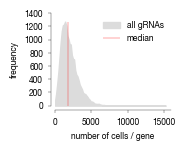

In [45]:
plot =  pd.read_csv("../data/Screen_Analysis/Raw_Data_reference_lysate.csv")
plot["normalized_counts_reference_cell_number"] = plot["normalized_counts_reference"]*40620231#multiply with the total number of cells imaged over 2.3 and 2.2 screen
plot = plot[plot.gene != "Non-Targeting Control"]

fig, ax = plt.subplots(1, 1, figsize = (1.5, 1.2))
sns.despine(offset = 3)

hist = np.histogram(plot.groupby("gene").sum()["normalized_counts_reference_cell_number"].values, bins = 100);
median = np.median(plot.groupby("gene").sum()["normalized_counts_reference_cell_number"])
print(median)
std = plot.groupby("gene").sum()["normalized_counts_reference_cell_number"].sem(axis = 0)

ax.fill_between(hist[1][:-1], hist[0], color='gainsboro', label = "all gRNAs")

y_max = np.ceil(np.max(hist[0])/200) * 200
x_max = np.ceil(np.max(hist[1])/2000) * 2000
ax.set_ylim(0, 1400)
ax.set_xlim(0, x_max)

ax.vlines(median, ymin = 0, ymax = hist[0].max(), color = "red", label = "median", linewidth = 0.25)
ax.set_xlabel("number of cells / gene")
ax.set_ylabel("frequency")

ax.legend(frameon=False)
ax.tick_params(width = 0.25)
ax.spines["bottom"].set_linewidth(0.25)
ax.spines["left"].set_linewidth(0.25)
ax.spines["right"].set_linewidth(0.25)
ax.tick_params(size = 2)
ax.set_yticks([0, 200, 400, 600, 800, 1000, 1200, 1400], [0, 200, 400, 600, 800, 1000, 1200, 1400])

fig.savefig("../plots/Screen_Analysis/histogram_n_cells_per_gene_complete_screen.pdf", transparent=True, format='pdf', bbox_inches='tight')

## Extended Data Figure 3d

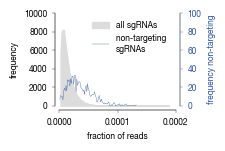

In [46]:
reference_lysate = pd.read_csv("../data/Screen_Analysis/Raw_Data_reference_lysate.csv")

hist_all = np.histogram(reference_lysate["normalized_counts_reference"], bins=100, density = False)
hist_non_targeting = np.histogram(reference_lysate[reference_lysate.gene == "Non-Targeting Control"]["normalized_counts_reference"], bins=100, density = False)

fig, ax = plt.subplots(figsize = (1.5, 1.2))
color = "#2f559a"
#plot distribution of all gRNAs
ax.fill_between(hist_all[1][1:], hist_all[0], color='gainsboro', label = "all sgRNAs")

#adjust y-axis and x-axis limits of first y-axis
y_max = np.ceil(np.max(hist_all[0])/10000) * 10000
x_max = np.ceil(np.max(hist_all[1])/0.00005) * 0.00005
ax.set_ylim(0, y_max)
ax.set_xlim(0, x_max)

ax.set_xticks(list(np.linspace(0, x_max, 3)))
ax.set_ylabel("frequency")
ax.set_xlabel("fraction of reads")
ax.tick_params(width = 0.25)
ax.spines["bottom"].set_linewidth(0.25)
ax.spines["left"].set_linewidth(0.25)
ax.spines["right"].set_linewidth(0.25)
ax.tick_params(size = 2)

#duplicate x-axis and add second y-axis to plot non-targeting gRNAs to
ax2 = ax.twinx()
ax2.tick_params(width = 0.25)
ax2.spines["bottom"].set_linewidth(0.25)
ax2.spines["left"].set_linewidth(0.25)

sns.lineplot(x = hist_non_targeting[1][:-1], y = hist_non_targeting[0], label = "non-targeting \nsgRNAs", linewidth=0.25, ax = ax2, color = color)

#adjust y-axis limits of second y-axis and label correctly
y_max = np.ceil(np.max(hist_non_targeting[0])/100) * 100
ax2.set_ylim(0, y_max)
ax2.set_ylabel("frequency non-targeting")

#change color of secondary y-axis
ax2.yaxis.label.set_color(color)          
ax2.tick_params(axis='y', colors=color, width = 0.25)    
ax2.spines['right'].set_color(color)
ax2.spines["right"].set_linewidth(0.25)
ax2.tick_params(size = 2)

#create legend
lines, labels = ax.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax2.legend(lines + lines2, labels + labels2,  frameon=False, fontsize = 6)

sns.despine(offset = 3, right= False)
fig.savefig("../plots/Screen_Analysis/histogram_gRNA_distribution_reference_lysate.pdf", transparent=True, format='pdf', bbox_inches='tight')

# Extended Data Figure 4

## Extended Data Figure 4b

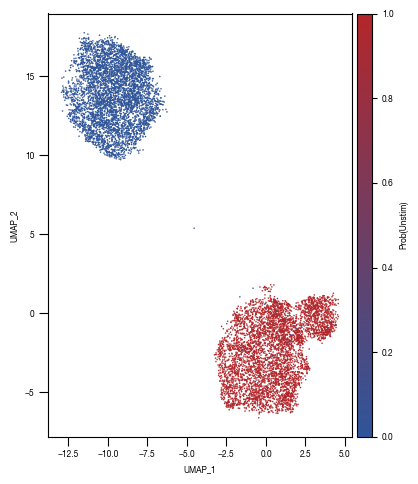

In [47]:
df_umap = pd.read_csv("../data/Screen_Analysis/screen_batches/Screen_B1_raw_data_UMAP.csv", index_col = 0)

from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib.colors import LinearSegmentedColormap

fig, axs = plt.subplots(1, 1, figsize = (5, 5))

c1='#B3262A'
c2='#2f559a'
c3 = "#FFFFFF"
cmap1 = LinearSegmentedColormap.from_list("Prob_Unstim", [c2, c1], N=500)
cmap = cmap1

sns.scatterplot(df_umap.sort_values(by= "class_label").sample(frac=1, random_state = 16),  x = "UMAP_1", y = "UMAP_2", s = 1, hue = "prob_unstim", alpha = 1, palette = cmap, ax = axs, edgecolor = None, rasterized=True)
sns.move_legend(axs, "upper left", bbox_to_anchor=(1, 1))
axs.set_aspect('equal', adjustable='box')
axs.tick_params(size = 3.5*1.773)

divider = make_axes_locatable(axs)
cax = divider.append_axes('right', size='5%', pad=0.05)

norm = plt.Normalize(0, 1.0)
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])

fig.colorbar(sm, cax=cax, orientation='vertical', label = "Prob(Unstim)")

# Remove the legend and add a colorbar
axs.get_legend().remove()

fig.tight_layout()
fig.savefig("../plots/Screen_Analysis/Screen_B1_UMAP_classification_score_colored.pdf", dpi = 500)

## Extended Data Figure 4c

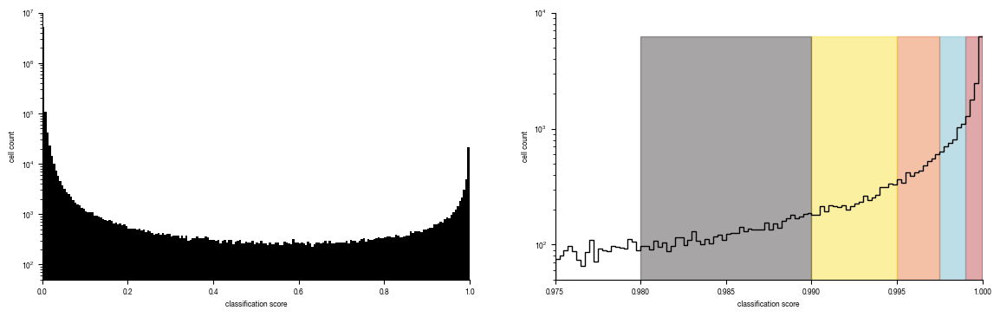

In [48]:
all_results = pd.read_parquet("../data/Screen_Analysis/screen_batches/ScreenB1_raw_data_cell_classification_values_with_bin_annotation.parquet")

bins = {"bin1": (0.99999, 1.0),
         "bin2": (0.999, 0.99999),
         "bin3": (0.9975, 0.999),
         "bin4": (0.995, 0.9975),
         "bin5": (0.99, 0.995),
         "bin6": (0.98, 0.99),
        } 

colors = ['#2f559a',"#B3262A","#5AADC5","#E46425","#F5DB12","#231F20","#D1D3D4"]

fig, axs = plt.subplots(1, 2, figsize = (14, 4))
sns.despine(offset = 0)

axs[0].hist(all_results.Prob_Unstim, bins = 200, bottom = 0, histtype = "stepfilled", color = "black");
axs[0].set_yscale("log")
axs[0].set_ylabel("cell count")
axs[0].set_xlabel("classification score")
axs[0].set_ylim(50, 10000000)
axs[0].set_xlim(0, 1)

hist = axs[1].hist(all_results[all_results.Prob_Unstim >= 0.975].Prob_Unstim, bins = 100, bottom = 0, histtype = "step", linewidth = 1, color = "black");
axs[1].set_yscale("log")
axs[1].set_ylabel("cell count")
axs[1].set_xlabel("classification score")
axs[1].set_xlim(0.975, 1)
axs[1].set_ylim(50, 10000)

for i, _bin in enumerate(bins.keys()):
    lower, upper = bins[_bin]
    
    rectangle = plt.Rectangle((lower, 0), upper-lower, hist[0].max(), fc=colors[i], alpha = 0.4, edgecolor = colors[i])
    plt.gca().add_patch(rectangle)

    
fig.savefig("../plots/Screen_Analysis/ScreenB1_binning_strategy.pdf")

## Extended Data Figure 4d

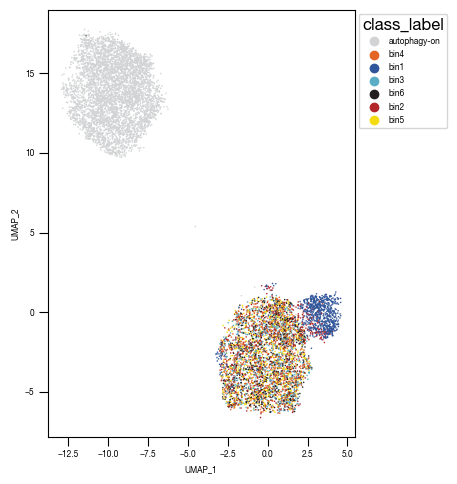

In [49]:
df_umap = pd.read_csv("../data/Screen_Analysis/screen_batches/Screen_B1_raw_data_UMAP.csv", index_col = 0)

fig, axs = plt.subplots(1, 1, figsize = (5, 5))

color_dict = dict({'bin1':'#2f559a',
                   "bin2":"#B3262A",
                   "bin3":"#5AADC5", 
                   "bin4":"#E46425",
                   "bin5":"#F5DB12",
                   "bin6":"#231F20",
                   "autophagy-on":"#D1D3D4"
                  })
sns.scatterplot(df_umap.sort_values(by= "class_label").sample(frac=1, random_state = 16),  x = "UMAP_1", y = "UMAP_2", s = 1, hue = "class_label", alpha = 1, palette = color_dict, ax = axs, edgecolor = None, rasterized=True)
sns.move_legend(axs, "upper left", bbox_to_anchor=(1, 1))
axs.set_aspect('equal', adjustable='box')
axs.tick_params(size = 3.5*1.773)

fig.tight_layout()
fig.savefig("../plots/Screen_Analysis/Screen_B1_UMAP_bins_colored.pdf", dpi = 500)

# Extended Data Figure 5

## Extended Data Figure 5a

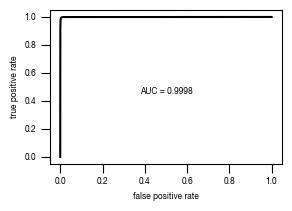

In [50]:
#load previously saved data
subsampled_classification_results = pd.read_csv("../data/T02_Raw_Data_classifier_metrics_classifier_2.0_2.1.csv")
versions = ["classifier_2.1"]

from sklearn.metrics import precision_recall_curve, roc_curve, auc
labels = ["stim", "ATG5_KO_Cr203_C6"]

results_all = {}
auc_values = {}

for version in versions:
    data = subsampled_classification_results.loc[[x in labels for x in subsampled_classification_results.label]].get([version, "label"])
    true_label = [0 if x == "stim" else 1 for x in data.label]
    scores = data[version].tolist()
    
    fpr, tpr, thresholds = roc_curve(true_label, scores)
    precision, recall, thresholds = precision_recall_curve(true_label, scores)
    fdr = 1 - precision
    
    auc_roc = auc(fpr, tpr)
    auc_precision_recall = auc(recall, precision)
    auc_values[version] = pd.DataFrame({"ROC":[auc_roc], "precision_recall":[auc_precision_recall]})
    
    fig, axs = plt.subplots(1, 1, figsize = (3, 2))
    axs.plot(fpr, tpr, color = "black")
    axs.set_xlabel("false positive rate")
    axs.set_ylabel("true positive rate")
    axs.tick_params(axis='both', which='major', labelsize=6, size = 3.5*1.773)
    auc_results = "{0:.4g}".format(auc_values[version].ROC[0])
    axs.text(x = 0.5, y= 0.45, s= f"AUC = {auc_results}", fontsize = 6, horizontalalignment= "center")
    fig.savefig(f"../plots/{version}/T02_{version}_tpr_fpr_curve.pdf")

## Extended Data Figure 5b

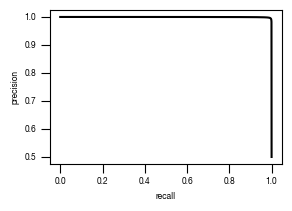

In [51]:
#load previously saved data
subsampled_classification_results = pd.read_csv("../data/T02_Raw_Data_classifier_metrics_classifier_2.0_2.1.csv")
versions = ["classifier_2.1"]

from sklearn.metrics import precision_recall_curve, roc_curve, auc
labels = ["stim", "ATG5_KO_Cr203_C6"]

results_all = {}
auc_values = {}

for version in versions:
    data = subsampled_classification_results.loc[[x in labels for x in subsampled_classification_results.label]].get([version, "label"])
    true_label = [0 if x == "stim" else 1 for x in data.label]
    scores = data[version].tolist()
    
    fpr, tpr, thresholds = roc_curve(true_label, scores)
    precision, recall, thresholds = precision_recall_curve(true_label, scores)
    fdr = 1 - precision
    
    auc_roc = auc(fpr, tpr)
    auc_precision_recall = auc(recall, precision)
    auc_values[version] = pd.DataFrame({"ROC":[auc_roc], "precision_recall":[auc_precision_recall]})
    
    fig, axs = plt.subplots(1, 1, figsize = (3, 2))
    axs.plot(recall, precision, color = "black")
    axs.set_xlabel("recall")
    axs.set_ylabel("precision")
    axs.tick_params(axis='both', which='major', labelsize=6, size = 3.5*1.773)
    fig.savefig(f"../plots/{version}/T02_{version}_precision_recall_curve.pdf")

## Extended Data Figure 5c

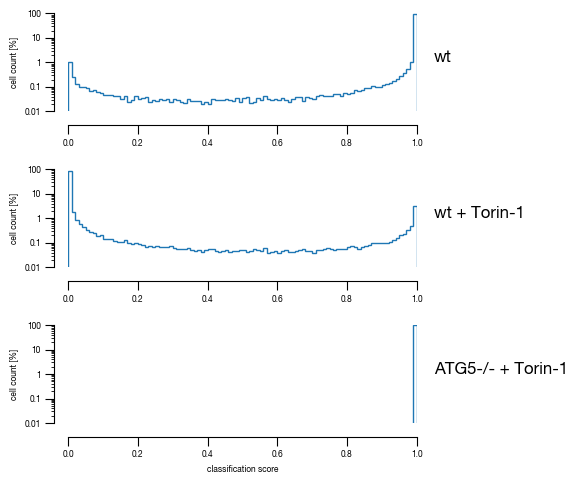

In [52]:
#load previously saved data
subsampled_classification_results = pd.read_csv("../data/T02_Raw_Data_classifier_metrics_classifier_2.0_2.1.csv")

slides = ["unstim", "stim", "ATG5_KO_Cr203_C6"]
labels = ["wt", "wt + Torin-1", "ATG5-/- + Torin-1"]
versions = ["classifier_2.1"]

from matplotlib.ticker import FormatStrFormatter

for version in versions:

    fig, axs = plt.subplots(3, 1, figsize = (6, 5), sharey = True)
    sns.despine(offset = 10)

    for i, slide in enumerate(slides):
        data = subsampled_classification_results.loc[[x == slide for x in subsampled_classification_results.label]].get([version])
        hist = axs[i].hist(data, bins = 100, cumulative = False, histtype='step', bottom = 0, weights = np.ones(len(data)) / len(data)*100)
        axs[i].set_ylim(0.01, 100)
        axs[i].set_yscale("log")
        axs[i].set_xlim(0, 1)
        axs[i].yaxis.set_major_formatter(FormatStrFormatter('%.3g'))

        axs[i].set_ylabel("cell count [%]")
        axs[i].tick_params(size = 3.5*1.773)
       
        axs[i].text(1.05, 1, s = labels[i])

    axs[i].set_xlabel("classification score")
    fig.tight_layout()
    fig.savefig(f"../plots/{version}/T02_{version}_Histogram_classifier_performance_lines.pdf", bbox_inches='tight')

## Extended Data Figure 5d

/tmp/ipykernel_1703410/2000922223.py:50: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



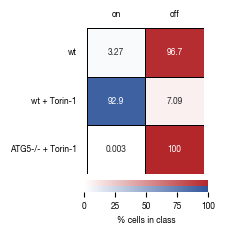

In [53]:
#load previously saved data
subsampled_classification_results = pd.read_csv("../data/T02_Raw_Data_classifier_metrics_classifier_2.0_2.1.csv")

sample_label_lookup = {"unstim":"wt", "stim":"wt + Torin-1", "ATG5_KO_Cr203_C6":"ATG5-/- + Torin-1"}

versions = ["classifier_2.1"]
n_cells = subsampled_classification_results.label.value_counts()[0]

for version in versions:
    _df = subsampled_classification_results.copy()
    _df["threshold_label"] = _df[version] >= 0.5    
    
    heatmap_data = pd.DataFrame(_df.groupby("label").sum().threshold_label/n_cells*100)
    heatmap_data.columns = ["unstimulated"]
    heatmap_data["stimulated"] = 100 - heatmap_data.unstimulated

    fig, axs = plt.subplots(1, 2, figsize = (2.3,2), sharex=False, sharey=True, gridspec_kw = {'wspace':0, 'hspace':0})
    
    cbar_ax1 = fig.add_axes([0.4, 0, 0.54, 0.03])
    cbar_ax2 = fig.add_axes([0.4, 0.03, 0.54, 0.03])
    
    sns.heatmap(heatmap_data.stimulated.to_frame().sort_index(ascending= False), annot = True, ax = axs[0], 
                cmap= cmap_stim, cbar_kws={'label': '% cells in class', "orientation": "horizontal"}, fmt = ".3g", vmax=100, vmin = 0, cbar_ax=cbar_ax1, 
                linewidths=0.5, linecolor='black',
                annot_kws={"size": 6})
    sns.heatmap(heatmap_data.unstimulated.to_frame().sort_index(ascending= False), annot = True, ax = axs[1], 
                cmap= cmap_unstim, cbar_kws={ "orientation": "horizontal"}, fmt = ".3g", vmax=100, vmin = 0, cbar_ax=cbar_ax2, 
                linewidths=0.5, linecolor='black', 
                annot_kws={"size": 6})
    
    #remove axis from second colorbar
    cbar_ax2.axis("off")
    
    #reassign labels into readable format
    labels = [sample_label_lookup[item.get_text()] for item in axs[0].get_yticklabels()]
    axs[0].set_yticklabels(labels)
    axs[0].set_xticklabels(["on"])
    axs[1].set_xticklabels(["off"])

    #move x-axis ticks to top and remove ticks
    axs[0].xaxis.set_ticks_position('top')
    axs[1].xaxis.set_ticks_position('top')
    axs[0].tick_params(left=False, top=False, bottom = False, rotation = 0)
    axs[1].tick_params(left=False, top=False, bottom = False, rotation = 0)
    
    #remove ylabel
    axs[0].set_ylabel(None)
    axs[1].set_ylabel(None)
    
    fig.tight_layout()
    fig.savefig(f"../plots/{version}/T02_{version}_heatmap.pdf", bbox_inches='tight')